# Understand ADC vs SCC model

In [1]:
import os
import sys
import random
import re
import math
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import cv2

# import self-defined image processing functions
from segmentation_functions import *

# import some image processing functions for dataset augmentation
from PIL import Image
import scipy
from scipy import ndimage

In [2]:
RGB_MARKERS = {
    'BG': [255, 255, 255],  # Background
    'Tumor': [0, 255, 0],  # Tumor
    'Stroma': [255, 0, 0],  # Stroma
    'Lymphocyte': [0, 0, 255],  # Lymphocyte
    'Blood': [255, 0, 255],  # Blood cell
    'Macrophage': [255, 255, 0],  # Macrophage
    'Karyorrhexis': [0, 148, 255]  # Dead nuclei
}

CLASSES = ['BG', 'Tumor', 'Stroma', 'Lymphocyte', 'Blood', 'Macrophage', 'Karyorrhexis']

In [3]:
MEAN = [149.91262888, 125.60738922, 155.41683322]
STD = [64.47969016, 65.98274776, 53.71798459]

# 1) Create models

In [4]:
import os
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

import sklearn.neighbors as skgraph
from scipy import sparse as sp
import networkx as nx

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch_geometric
from torch_geometric.nn import GCNConv, NNConv, global_max_pool, global_mean_pool
from torch_geometric.data import Data
from torch_scatter import scatter_mean

os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "2"

In [5]:
x_ave = np.array([2.62e+02, 2.76e+02, # area, convex_area, 
                   7.44e-01, 7.02e-01, 2.62e+02, 2.32e+01,  # eccentricity, extent, filled_area, major_axis_length
                   1.32e+01, 1.54e+01, 5.97e+01, 8.63e-01,  # minor_axis_length, pa_ratio, perimeter, probability
                   9.52e-01])  # solidity

x_std = np.array([2.34e+02, 2.49e+02,  # area, convex_area,
                   1.61e-01, 1.04e-01, 2.34e+02, 1.13e+01,  # eccentricity, extent, filled_area, major_axis_length
                   5.31e+00, 4.07e+00, 2.76e+01, 7.25e-02,  # minor_axis_length, pa_ratio, perimeter, probability
                   3.78e-02])   # solidity

In [6]:
nlst_adc_slide_dir = "/archive/DPDS/Xiao_lab/shared/hudanyun_sheng/pathology_image_data/NLST_ADC"
nlst_scc_slide_dir = "/archive/DPDS/Xiao_lab/shared/hudanyun_sheng/pathology_image_data/NLST_SCC/images"
tcga_scc_slide_dir = "/archive/DPDS/Xiao_lab/shared/hudanyun_sheng/pathology_image_data/TCGA_LUSC/images/"

In [7]:
nlst_adc_data_dir = "/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated"
nlst_scc_data_dir = "/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_SCC_100_patches"
tcga_luad_data_dir = "/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/TCGA_LUAD_100_patches_updated"
tcga_lusc_data_dir = "/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/TCGA_LUSC_100_patches"

In [8]:
class NucleiData(Data):
    """Add some attributes to Data object.
    
    Args:
        * All args mush be torch.tensor. So string is not supported.
        x: Matrix for nodes
        cell_type: cell type
        edge_index: 2*N matrix
        edge_attr: edge types
        y: Label
        pid: Patient ID
        region_id: Region ID, range from 0~99
    """
    def __init__(self, x=None, cell_type=None, edge_index=None, edge_attr=None, y=None, pos=None, pid=None, region_id=None):
        super().__init__(x, edge_index, edge_attr, y, pos)
        self.cell_type = cell_type
        self.pid = pid
        self.region_id = region_id
        
    def __repr__(self):
        info = ['{}={}'.format(key, self.size_repr(item)) for key, item in self]
        return '{}({})'.format(self.__class__.__name__, ', '.join(info))
    
    @staticmethod
    def size_repr(value):
        if torch.is_tensor(value):
            return list(value.size())
        elif isinstance(value, int) or isinstance(value, float) or isinstance(value, str):
            return [1]
        else:
            raise ValueError('Unsupported attribute type.')
            
def get_edge_type(edge, cell_type):
    """
    Args: 
        edge: (in_cell_index, out_cell_index, 1/edge_length)
        
    Returns:
        edge type index.
        0: 1-1; 1: 1-2; 2: 1-3; 3: 1-4; 4: 1-5; 5: 1-6
        6: 2-1; 7: 2-2; 8: 2-3; 9: 2-4; 10: 2-5; 11: 2-6
        12: 3-1; 13: 3-2; 14: 3-3; 15: 3-4; 16: 3-5; 17: 3-6
        18: 4-1; 19: 4-2; 20: 4-3; 21: 4-4; 22: 4-5; 23: 4-6
        24: 5-1; 25: 5-2; 26: 5-3; 27: 5-4; 28: 5-5; 29: 5-6
        30: 6-1; 31: 6-2; 32: 6-3; 33: 6-4; 34: 6-5; 35: 6-6
    """
    mapping = {"1-1": 0, "1-2": 1, "1-3": 2, "1-4": 3, "1-5": 4, "1-6": 5,
                   "2-1": 6, "2-2": 7, "2-3": 8, "2-4": 9, "2-5": 10, "2-6": 11,
                   "3-1": 12, "3-2": 13, "3-3": 14, "3-4": 15, "3-5": 16, "3-6": 17,
                   "4-1": 18, "4-2": 19, "4-3": 20, "4-4": 21, "4-5": 22, "4-6": 23,
                   "5-1": 24, "5-2": 25, "5-3": 26, "5-4": 27, "5-5": 28, "5-6": 29,
                   "6-1": 30, "6-2": 31, "6-3": 32, "6-4": 33, "6-5": 34, "6-6": 35}
    return mapping['{}-{}'.format(cell_type[edge[0]], cell_type[edge[1]])]

def get_nuclei_orientation_diff(edge, nuclei_orientation):
    return np.cos(nuclei_orientation[edge[0]] - nuclei_orientation[edge[1]])

In [9]:
class EdgeNN(nn.Module):
    """
    Design: embedding according to edge type, and then modulated by edge features.
    """
    def __init__(self, in_channels, out_channels, n_edge_types=36):
        super(EdgeNN, self).__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        
        self.edge_type_embedding = nn.Embedding(n_edge_types, out_channels)
        self.fc_h = nn.Linear(in_channels, out_channels)
        self.fc_g = nn.Linear(in_channels, out_channels)
        # self.bn = nn.BatchNorm(out_channels, eps=0.001)
        
    def forward(self, x):
        """
        Args:
            x: [batch_size, n_edges, 1(edge type) + in_channels]
        
        return: [batch_size, out_channels]
        """
        y = self.edge_type_embedding(x[..., 0].clone().detach().type(torch.long).to(device))
        h = self.fc_h(x[..., 1:(self.in_channels + 1)].clone().detach().type(torch.float).to(device))
        g = self.fc_g(x[..., 1:(self.in_channels + 1)].clone().detach().type(torch.float).to(device))
        y = y * h + g
        # x = self.bn(x)
        return F.relu(y, inplace=True)

class NucleiNet(torch.nn.Module):
    def __init__(self, in_channels, out_channels, batch=True, edge_features=2, n_edge_types=36):
        """
        Args:
            in_channels: No. of node features
            out_channels: No. of output node features (e.g., No. classes for classification)
            batch: True if from DataLoader; False if single Data object
            edge_features: No. of edge features (excluding edge type)
            n_edge_types: No. of edge types
        """
        super(NucleiNet, self).__init__()
        self.batch=batch
        
        self.conv1 = NNConv(in_channels, 10, EdgeNN(edge_features, in_channels*10, n_edge_types=n_edge_types), 
                            aggr='mean', root_weight=True, bias=True)
        self.conv2 = NNConv(10, 10, EdgeNN(edge_features, 10*10, n_edge_types=n_edge_types), 
                            aggr='mean', root_weight=True, bias=True)
        self.conv3 = NNConv(10, out_channels, EdgeNN(edge_features, 10*out_channels, n_edge_types=n_edge_types), 
                            aggr='mean', root_weight=True, bias=True)
        
    def forward(self, data):
        """
        Args:
            data: Data in torch_geometric.data
        """
        x, edge_index, edge_attr = data.x, data.edge_index, data.edge_attr
        x = self.conv1(x, edge_index, edge_attr)
        x = F.relu(x)
        x = F.dropout(x, training=self.training)
        x = self.conv2(x, edge_index, edge_attr)
        x = F.relu(x)
        x = F.dropout(x, training=self.training)
        x = self.conv3(x, edge_index, edge_attr)
        x = F.relu(x)
        '''
        if self.batch:
            x = global_max_pool(x, batch=data.batch).to(device)
        else:
            x = global_max_pool(x, batch=torch.tensor(np.zeros(x.shape[0]), dtype=torch.long).to(device))
        '''
        # cell_type = data.cell_type
        # gate = data.cell_type
        gate = torch.eq(data.cell_type, 1).clone().detach().requires_grad_(False).type(torch.long).to(device)
        # print(np.unique(data.batch.cpu().numpy()))  ## [0, 1, 2, ... BATCH_SIZE-1]
        # print(gate * data.batch)  ## [[0]s, [1]s, .... [BATCH_SIZE - 1]s]
        if self.batch:
            _batch_size = data.batch[-1] + 1
            x = scatter_mean(x, gate * (data.batch+1), dim=0).to(device)[1:_batch_size+1, :]  # Keep the batches
            # print(x.shape)  ## [BATCH_SIZE, 2]
        else:
            x = scatter_mean(x, gate, dim=0).to(device)[1, :]
            # print(x.shape)  ## [2]
        
        # return F.log_softmax(x, dim=1)
        return x

In [10]:
global device
device = 'cpu'

print(torch.cuda.current_device())
print(torch.cuda.device_count())
print(torch.cuda.get_device_name(0))

0
4
Tesla V100-SXM2-32GB


In [11]:
model = NucleiNet(11, 2, batch=False)
model.to(device)
model.load_state_dict(torch.load("./models/cell_graph_ADC_vs_SCC_2_11042019/epoch_285.pt", 
                                 map_location=device))
model.eval()

NucleiNet(
  (conv1): NNConv(11, 10)
  (conv2): NNConv(10, 10)
  (conv3): NNConv(10, 2)
)

## Create the model that only x requires gradient

In [12]:
class EdgeNNRe(nn.Module):
    """
    Design: embedding according to edge type, and then modulated by edge features.
    """
    def __init__(self, in_channels, out_channels, n_edge_types=36):
        super(EdgeNNRe, self).__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        
        self.edge_type_embedding = nn.Embedding(n_edge_types, out_channels)
        self.fc_h = nn.Linear(in_channels, out_channels)
        self.fc_g = nn.Linear(in_channels, out_channels)
        # self.bn = nn.BatchNorm(out_channels, eps=0.001)
        
    def forward(self, x):
        """
        Args:
            x: [batch_size, n_edges, 1(edge type) + in_channels]
        
        return: [batch_size, out_channels]
        """
        y = self.edge_type_embedding(x[..., 0].type(torch.long).to(device))
        h = self.fc_h(x[..., 1:(self.in_channels + 1)].type(torch.float).to(device))
        g = self.fc_g(x[..., 1:(self.in_channels + 1)].type(torch.float).to(device))
        y = y * h + g
        # x = self.bn(x)
        return F.relu(y, inplace=True)

# Reversed gradient-variable
class NucleiNetRe(torch.nn.Module):
    def __init__(self, in_channels, out_channels, batch=True, edge_features=2, n_edge_types=36):
        """
        Args:
            in_channels: No. of node features
            out_channels: No. of output node features (e.g., No. classes for classification)
            batch: True if from DataLoader; False if single Data object
            edge_features: No. of edge features (excluding edge type)
            n_edge_types: No. of edge types
        """
        super(NucleiNetRe, self).__init__()
        self.batch=batch
        
        self.conv1 = NNConv(in_channels, 10, EdgeNNRe(edge_features, in_channels*10, n_edge_types=n_edge_types), 
                            aggr='mean', root_weight=True, bias=True)
        self.conv2 = NNConv(10, 10, EdgeNNRe(edge_features, 10*10, n_edge_types=n_edge_types), 
                            aggr='mean', root_weight=True, bias=True)
        self.conv3 = NNConv(10, out_channels, EdgeNNRe(edge_features, 10*out_channels, n_edge_types=n_edge_types), 
                            aggr='mean', root_weight=True, bias=True)
        
    def forward(self, data):
        """
        Args:
            data: Data in torch_geometric.data
        """
        x, edge_index, edge_attr = data.x, data.edge_index, data.edge_attr
        x = self.conv1(x, edge_index, edge_attr)
        x = F.relu(x)
        x = F.dropout(x, training=self.training)
        x = self.conv2(x, edge_index, edge_attr)
        x = F.relu(x)
        x = F.dropout(x, training=self.training)
        x = self.conv3(x, edge_index, edge_attr)
        x = F.relu(x)
        '''
        if self.batch:
            x = global_max_pool(x, batch=data.batch).to(device)
        else:
            x = global_max_pool(x, batch=torch.tensor(np.zeros(x.shape[0]), dtype=torch.long).to(device))
        '''
        # cell_type = data.cell_type
        # gate = data.cell_type
        gate = torch.eq(data.cell_type, 1).clone().detach().requires_grad_(False).type(torch.long).to(device)
        # print(np.unique(data.batch.cpu().numpy()))  ## [0, 1, 2, ... BATCH_SIZE-1]
        # print(gate * data.batch)  ## [[0]s, [1]s, .... [BATCH_SIZE - 1]s]
        if self.batch:
            _batch_size = data.batch[-1] + 1
            x = scatter_mean(x, gate * (data.batch+1), dim=0).to(device)[1:_batch_size+1, :]  # Keep the batches
            # print(x.shape)  ## [BATCH_SIZE, 2]
        else:
            x = scatter_mean(x, gate, dim=0).to(device)[1, :]
            # print(x.shape)  ## [2]
        
        # return F.log_softmax(x, dim=1)
        return x

# 2) Try an ADC slide

In [13]:
# Set color
import matplotlib as mpl
import matplotlib.cm as cm
from matplotlib.colorbar import ColorbarBase

In [14]:
pid = 0
i = 0
slide_id = "9388.svs"
patch_id = 9

# Read image patch & nuclei
cell_summary = pd.read_csv(os.path.join(nlst_adc_data_dir, slide_id, "cell_summary_40X_100patches.csv"))
patch_summary = cell_summary[cell_summary['n_patch'] == patch_id]
patch_coords = pd.read_csv(os.path.join(nlst_adc_data_dir, slide_id, "patch_summary_40X_100patches.csv"))

# Plot image
slide_file = os.path.join("/archive/DPDS/Xiao_lab/shared/hudanyun_sheng/pathology_image_data/NLST_ADC", slide_id)
image = extract_patch_by_location(slide_file, 
                                  location=(patch_coords['coordinate_x'][patch_id], 
                                            patch_coords['coordinate_y'][patch_id]),
                                  patch_size=(1024, 1024))
image = np.array(image)[..., :3]

# Plot nuclei
coord_x, coord_y = patch_coords.ix[patch_id, ["coordinate_x", "coordinate_y"]].values
coordinate_x = patch_summary['coordinate_x'] - patch_coords['coordinate_x'][patch_id]
coordinate_y = patch_summary['coordinate_y'] - patch_coords['coordinate_y'][patch_id]

mycolors = np.array(["lime", "red", "blue", "magenta", "yellow", "cyan"])
mycolor = mycolors[patch_summary['cell_type'] - 1]

# Construct graph data
if len(patch_summary['cell_type'] == 1) < 20:
    raise Exception("Too few tumor cells.")

# Create 8 nearest neighbors graph
graph = skgraph.kneighbors_graph(np.array(patch_summary.loc[:, ['coordinate_x', 'coordinate_y']]), 
                                 n_neighbors=8, mode='distance')
I, J, V = sp.find(graph)
edges = list(zip(I, J, 1/V))
edge_index = np.transpose(np.array(edges)[:, 0:2])
x = (np.array(patch_summary.loc[:, ['area', 'convex_area', 
                                   'eccentricity', 'extent', 'filled_area', 
                                    'major_axis_length', 'minor_axis_length', 'pa_ratio', 
                                    'perimeter', 'probability', 'solidity']]) - x_ave)/x_std
cell_type = np.array(patch_summary['cell_type'])
orientation = np.array(patch_summary['orientation'])

# Edge features
edge_type = list(map(lambda x: get_edge_type(x, cell_type), edges))
nuclei_orientation = list(map(lambda x: get_nuclei_orientation_diff(x, orientation), edges))
edge_attr = np.transpose(np.array([edge_type, nuclei_orientation, 1/V]))

data = NucleiData(x=torch.tensor(x, dtype=torch.float), 
                  cell_type=torch.tensor(cell_type, dtype=torch.long),
                  edge_index=torch.tensor(edge_index, dtype=torch.long),
                  edge_attr=torch.tensor(edge_attr, dtype=torch.float),
                  y=torch.tensor([[0]]),
                  pid=torch.tensor([[i]]),
                  region_id=torch.tensor([[patch_id]]))

# data.x = torch.zeros_like(data.x) + 1

model(data.to(device)).detach().cpu().numpy().squeeze()

/home2/swan15/.conda/envs/mask_rcnn_danni/lib/python3.6/site-packages/ipykernel/__main__.py:20: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([10.98462  ,  7.8705583], dtype=float32)

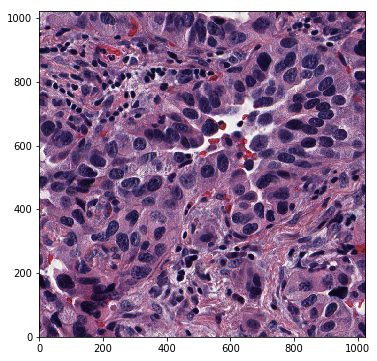

In [15]:
f = plt.figure(figsize=(6, 6))
plt.imshow(image)
plt.xlim((0, 1024))
plt.ylim((0, 1024))
# f.savefig(fname="./writing/10857_30_centroids.pdf")
plt.show()

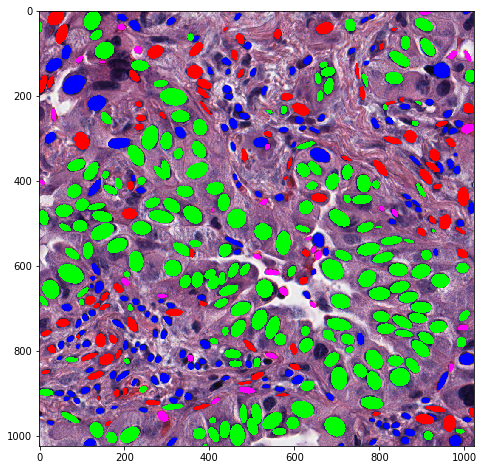

In [16]:
# Reconstruct segmentation
h, w = 1024, 1024
# mycolors = np.array(["lime", "red", "blue", "magenta", "yellow", "cyan"])
mycolors = np.array([[0, 255, 0], [255, 0, 0], [0, 0, 255], [255, 0, 255], [255, 255, 0], [0, 255, 255]])
roi_pred_image = image.copy()
for index, (_, cell) in enumerate(patch_summary.iterrows()):
    y, x = skimage.draw.ellipse(cell['coordinate_x'] - patch_coords['coordinate_x'][patch_id], 
                                cell['coordinate_y'] - patch_coords['coordinate_y'][patch_id], 
                                cell['major_axis_length']/2, cell['minor_axis_length']/2, 
                                rotation=-cell['orientation'])
    c = np.logical_and.reduce([x>0, x<h, y>0, y<w])
    x, y = x[c], y[c]
    roi_pred_image[x, y, :] = mycolors[int(cell['cell_type'] - 1)]
    
plt.figure(figsize=(8, 8))
plt.imshow(roi_pred_image)
plt.show()

In [17]:
model_re = NucleiNetRe(11, 2, batch=False)
model_re.to(device)
model_re.load_state_dict(
        torch.load("./models/cell_graph_ADC_vs_SCC_2_11042019/epoch_285.pt",
        map_location=device),
    strict=True)
model_re.eval()

from torch import optim
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model_re.parameters(), 
                      lr=0.001, 
                      momentum=0.9,
                      weight_decay=0.005)
data.x.requires_grad_(True)
data.edge_attr.requires_grad_(True)
grad_edge = []
# data.x.register_hook(lambda grad: print(grad))
data.edge_attr.register_hook(lambda grad: grad_edge.append(grad))

# For gradients of parameters in model
# def hookFunc(module, gradInput, gradOutput):
#     print(len(gradInput))
#     for v in gradInput:
#         print(v)
# model_re.conv1.register_backward_hook(hookFunc)

# Forward and backward
outputs = model_re(data.to(device))
loss = criterion(outputs[None, :], torch.tensor([0]))
optimizer.zero_grad()
loss.backward()
optimizer.step()

In [18]:
data.x.grad

tensor([[-6.3287e-05, -2.8733e-04,  3.2662e-04,  ...,  3.9288e-04,
         -1.1863e-03,  1.2779e-03],
        [-2.6009e-05, -2.8944e-04,  3.3356e-04,  ...,  4.1123e-04,
         -1.4906e-03,  1.2993e-03],
        [-2.1143e-05, -1.3989e-04,  1.3405e-04,  ...,  1.1376e-04,
         -5.8617e-04,  6.0122e-04],
        ...,
        [-2.1517e-05, -6.3899e-05,  2.2860e-05,  ..., -9.9334e-06,
          2.1952e-05,  2.4037e-04],
        [ 3.5129e-04,  2.2025e-04,  3.4150e-04,  ...,  8.7840e-04,
          6.5528e-04,  1.1630e-03],
        [ 5.4322e-04,  2.9676e-04,  7.0549e-04,  ...,  1.6027e-03,
          3.4857e-04,  2.1083e-03]])

In [19]:
data.edge_attr.grad

tensor([[ 0.0000e+00,  2.5254e-04, -8.3118e-05],
        [ 0.0000e+00, -1.3383e-04, -8.6002e-05],
        [ 0.0000e+00,  2.7026e-04, -1.1406e-04],
        ...,
        [ 0.0000e+00, -1.1007e-04,  2.5587e-05],
        [ 0.0000e+00,  1.8833e-04,  1.0289e-05],
        [ 0.0000e+00, -4.6224e-05,  3.2896e-05]])

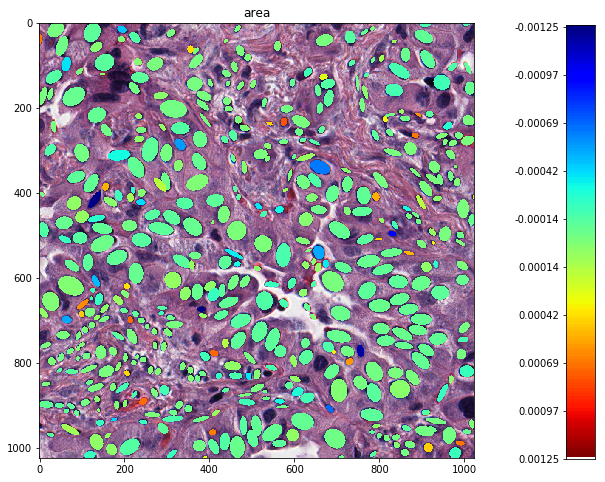

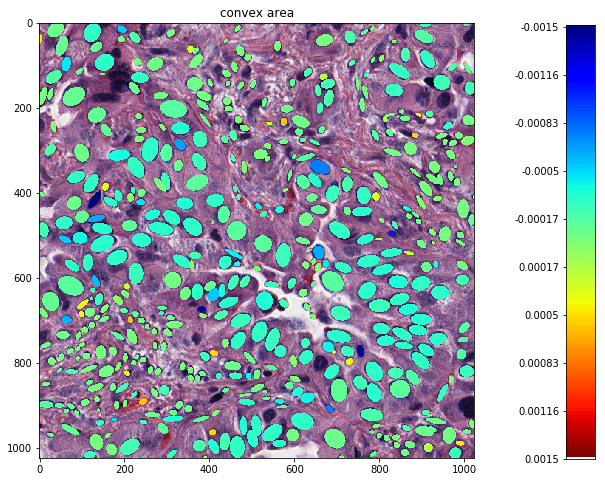

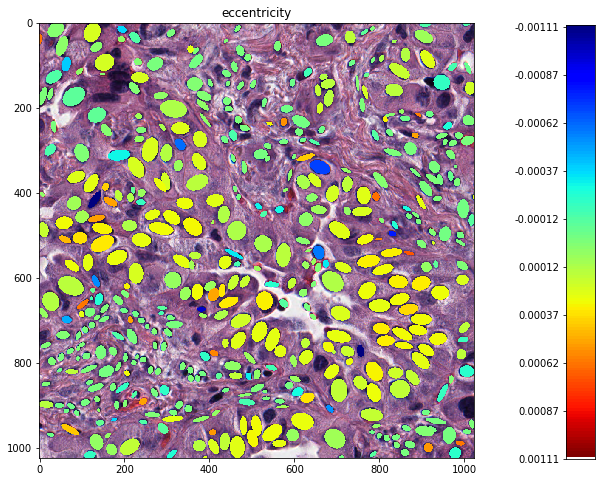

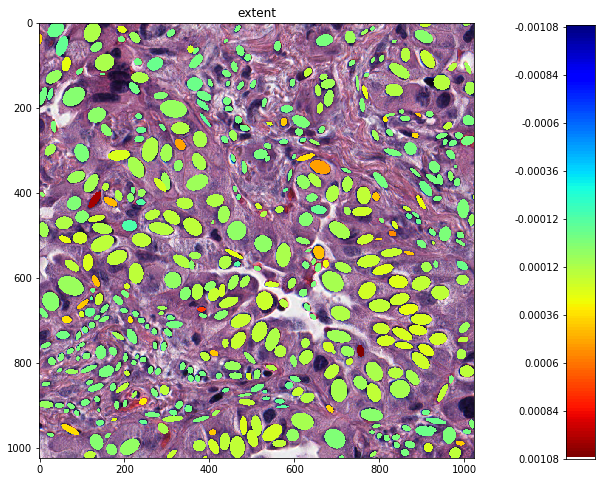

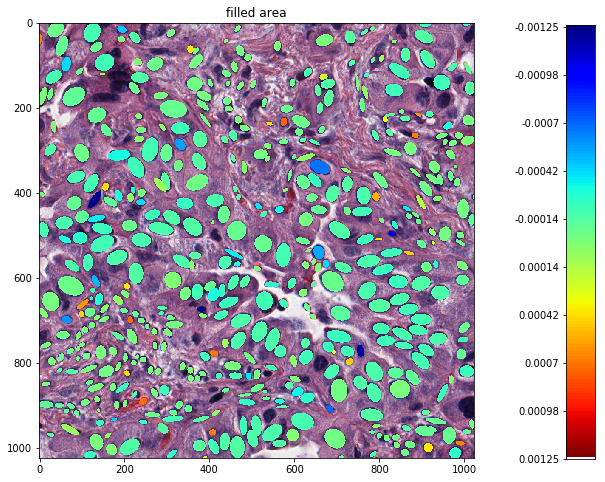

...

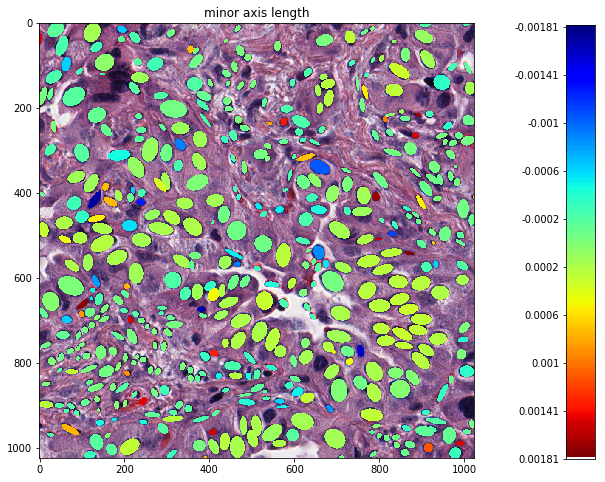

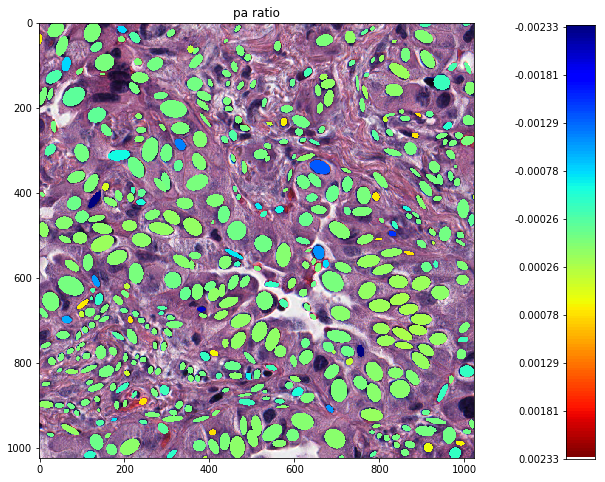

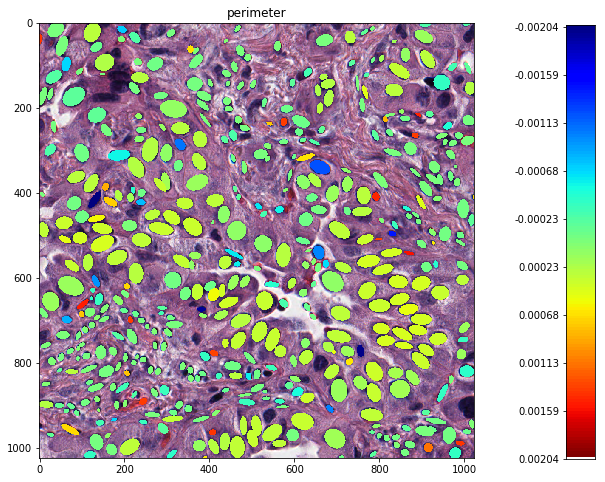

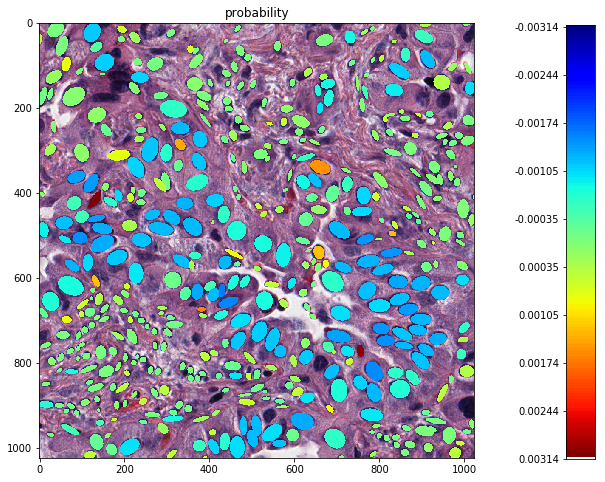

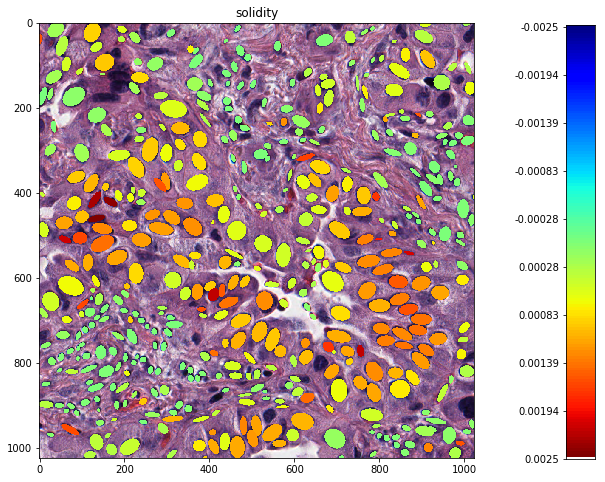

In [20]:
# Plot gradient of data.x
x_feature_names = ["area", "convex area", "eccentricity", 
                     "extent", "filled area", "major axix length", 
                     "minor axis length", "pa ratio", "perimeter", "probability", 
                     "solidity"]

for i in range(11):
    cell_feature_attributes = data.x.grad.numpy()[:, i]
    
    vmax = np.max(np.abs(data.x.grad.numpy()[:, i]))
    vmin = -vmax

    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
    cmap = cm.jet
    m = cm.ScalarMappable(norm=norm, cmap=cmap)
    mycolor_risk = m.to_rgba(cell_feature_attributes)

    # Reconstruct segmentation
    h, w = 1024, 1024
    # mycolors = np.array(["lime", "red", "blue", "magenta", "yellow", "cyan"])
    mycolors = np.array([[0, 255, 0], [255, 0, 0], [0, 0, 255], [255, 0, 255], [255, 255, 0], [0, 255, 255]])
    # roi_pred_image = image.copy()
    # Change alpha
    alpha = 1
    roi_pred_image = (image * alpha + (np.zeros_like(image) + 255) * (1 - alpha)).astype(np.uint8)
    for index, (_, cell) in enumerate(patch_summary.iterrows()):
        y, x = skimage.draw.ellipse(cell['coordinate_x'] - patch_coords['coordinate_x'][patch_id], 
                                    cell['coordinate_y'] - patch_coords['coordinate_y'][patch_id], 
                                    cell['major_axis_length']/2, cell['minor_axis_length']/2, 
                                    rotation=-cell['orientation'])
        c = np.logical_and.reduce([x>0, x<h, y>0, y<w])
        x, y = x[c], y[c]
        roi_pred_image[x, y, :] = mycolor_risk[index][:3] * 255
        
#         if cell['cell_type'] == 1:
#             # Mark tumor cells
#             label_img = np.zeros((h, w), dtype=int)
#             label_img[x, y] = 1
#             roi_pred_image = np.array(skimage.segmentation.mark_boundaries(roi_pred_image, label_img, color=(1, 1, 1), 
#                                                  outline_color=None, mode='thick', background_label=0)*255, dtype=np.uint8)
    
    fig, ax = plt.subplots(figsize=(8, 8))
    im1 = plt.imshow(roi_pred_image)
    plt.title(x_feature_names[i])
    # Add colorbar
    colorbar = list(np.linspace(vmin, vmax, 150))*10
    colorbar = np.array(colorbar).reshape(-1, 10, order='F')
    cax = fig.add_axes([1.05, 0, 0.05, 1])
    im2 = cax.imshow(colorbar, cmap='jet')
    cax.set_xticks([])
    cax.set_xticklabels([])
    cax.set_yticks(np.linspace(colorbar.shape[0], 0, 10))
    cax.set_yticklabels(np.round(np.linspace(vmax, vmin, 10), 5))
    # End of adding colorbar
    plt.show()

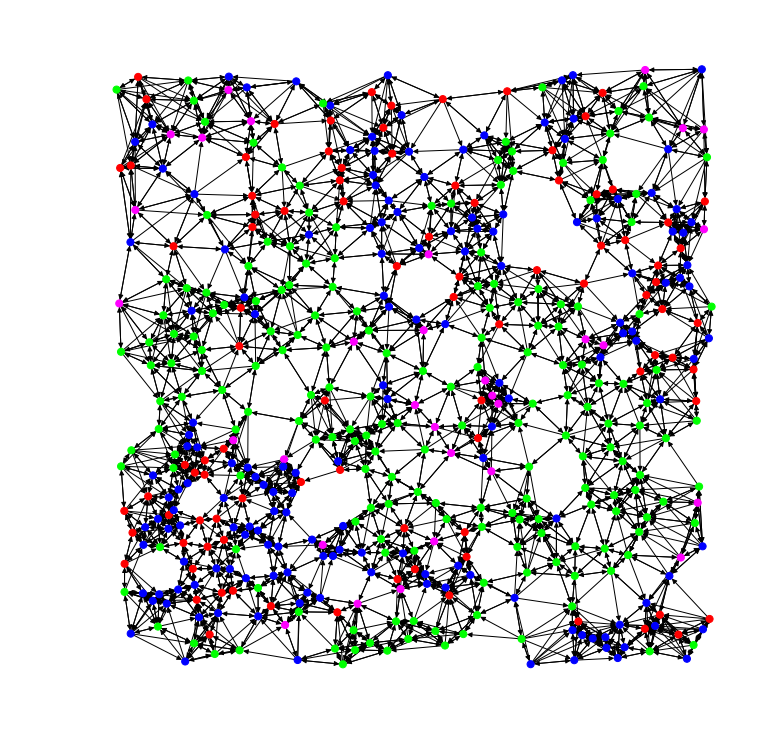

In [21]:
DG = nx.DiGraph()
DG.add_nodes_from(list(zip(np.arange(0, patch_summary.shape[0]), [dict(label=i) for i in patch_summary['cell_type'].values])))
DG.add_weighted_edges_from(edges)

# Plot graph
plt.figure(figsize=(10, 10))
pos = {}
for i in range(patch_summary.shape[0]):
    pos[i] = [patch_summary['coordinate_x'].values[i], -patch_summary['coordinate_y'].values[i]]
nx.draw(DG, pos=pos, with_labels=False, node_color=mycolor, node_size=50)
plt.show()

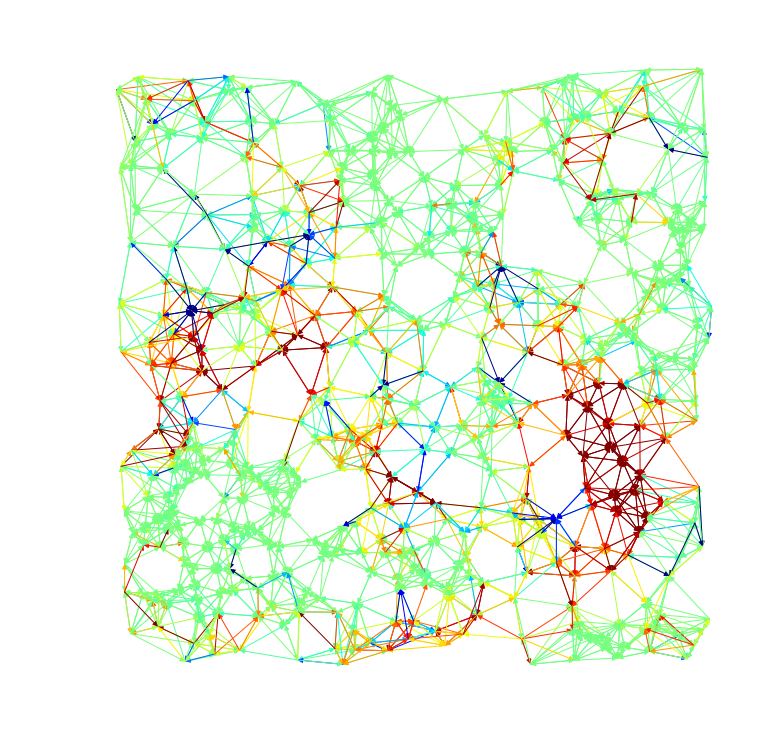

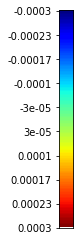

In [22]:
# Plot gradient of data.edge_attr[:, 1] (1/distance)
# vmin = np.min(data.edge_attr.grad.numpy()[:, 1])
# vmax = np.max(data.edge_attr.grad.numpy()[:, 1])
vmin = -0.0003
vmax = 0.0003
x_feature_names = ["distance", "angle"]

edge_feature_attributes = data.edge_attr.grad.numpy()[:, 1]

norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
cmap = cm.jet
m = cm.ScalarMappable(norm=norm, cmap=cmap)
mycolor_risk = m.to_rgba(edge_feature_attributes)

DG = nx.DiGraph()
DG.add_nodes_from(list(zip(np.arange(0, patch_summary.shape[0]), [dict(label=i) for i in patch_summary['cell_type'].values])))
# DG.add_weighted_edges_from(edges)  # Not right

# Plot graph
plt.figure(figsize=(10, 10))
pos = {}
for i in range(patch_summary.shape[0]):
    pos[i] = [patch_summary['coordinate_x'].values[i], -patch_summary['coordinate_y'].values[i]]
nx.draw(DG, pos=pos, with_labels=False, node_color=mycolor, node_size=0,   # Node_size was 50
        edge_color=mycolor_risk, edgelist=edges)
plt.show()

# Plot colorbar
colorbar = list(np.linspace(vmin, vmax, 150))*10
colorbar = np.array(colorbar).reshape(-1, 10, order='F')
plt.imshow(colorbar, cmap='jet')
plt.xticks([], [])
plt.yticks(np.linspace(colorbar.shape[0], 0, 10), np.round(np.linspace(vmax, vmin, 10), 5))
plt.show()

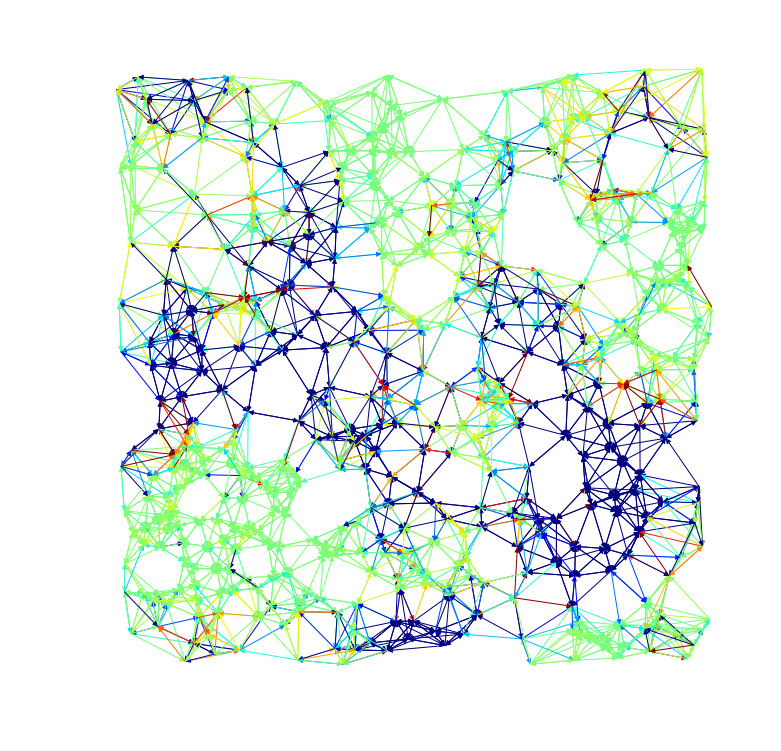

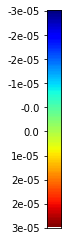

In [23]:
# Plot gradient of data.edge_attr[:, 2] (angle)
# vmin = np.min(data.edge_attr.grad.numpy()[:, 2])
# vmax = np.max(data.edge_attr.grad.numpy()[:, 2])
vmin = -0.00003
vmax = 0.00003
x_feature_names = ["distance", "angle"]

edge_feature_attributes = data.edge_attr.grad.numpy()[:, 2]

norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
cmap = cm.jet
m = cm.ScalarMappable(norm=norm, cmap=cmap)
mycolor_risk = m.to_rgba(edge_feature_attributes)

DG = nx.DiGraph()
DG.add_nodes_from(list(zip(np.arange(0, patch_summary.shape[0]), [dict(label=i) for i in patch_summary['cell_type'].values])))
# DG.add_weighted_edges_from(edges)

# Plot graph
plt.figure(figsize=(10, 10))
pos = {}
for i in range(patch_summary.shape[0]):
    pos[i] = [patch_summary['coordinate_x'].values[i], -patch_summary['coordinate_y'].values[i]]
nx.draw(DG, pos=pos, with_labels=False, node_color=mycolor, node_size=0,   # node size was 50
        edge_color=mycolor_risk, edgelist=edges)
plt.show()

# Plot colorbar
colorbar = list(np.linspace(vmin, vmax, 150))*10
colorbar = np.array(colorbar).reshape(-1, 10, order='F')
plt.imshow(colorbar, cmap='jet')
plt.xticks([], [])
plt.yticks(np.linspace(colorbar.shape[0], 0, 10), np.round(np.linspace(vmax, vmin, 10), 5))
plt.show()

### Another SCC slide

In [24]:
slide_file = os.path.join(tcga_scc_slide_dir, "TCGA-43-3394-01Z-00-DX1.4c2f49b9-9dac-41d8-a62b-64c8928caa3c.svs")
patch_id = 70
patch_coords = pd.read_csv("/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/TCGA_LUSC_100_patches/TCGA-43-3394-01Z-00-DX1.4c2f49b9-9dac-41d8-a62b-64c8928caa3c.svs/patch_summary_40X_100patches.csv")
centroids = pd.read_csv("/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/TCGA_LUSC_100_patches/TCGA-43-3394-01Z-00-DX1.4c2f49b9-9dac-41d8-a62b-64c8928caa3c.svs/cell_summary_40X_100patches.csv")
patch_summary = centroids[centroids['which_patch'] == patch_id]

# Plot image
image = extract_patch_by_location(slide_file, 
                                  location=(patch_coords['coordinate_x'][patch_id], 
                                            patch_coords['coordinate_y'][patch_id]),
                                  patch_size=(1024, 1024))
image = np.array(image)[..., :3]

# Plot nuclei
coord_x, coord_y = patch_coords.ix[patch_id, ["coordinate_x", "coordinate_y"]].values
coordinate_x = patch_summary['coordinate_x'] - patch_coords['coordinate_x'][patch_id]
coordinate_y = patch_summary['coordinate_y'] - patch_coords['coordinate_y'][patch_id]

mycolors = np.array(["lime", "red", "blue", "magenta", "yellow", "cyan"])
mycolor = mycolors[patch_summary['cell_type'] - 1]

# Construct graph data
if len(patch_summary['cell_type']) < 20:
    raise Exception("Too few tumor cells.")

# Create 8 nearest neighbors graph
graph = skgraph.kneighbors_graph(np.array(patch_summary.loc[:, ['coordinate_x', 'coordinate_y']]), 
                                 n_neighbors=8, mode='distance')
I, J, V = sp.find(graph)
edges = list(zip(I, J, 1/V))
edge_index = np.transpose(np.array(edges)[:, 0:2])
x = (np.array(patch_summary.loc[:, ['area', 'convex_area', 
                                   'eccentricity', 'extent', 'filled_area', 
                                    'major_axis_length', 'minor_axis_length', 'pa_ratio', 
                                    'perimeter', 'probability', 'solidity']]) - x_ave)/x_std
cell_type = np.array(patch_summary['cell_type'])
orientation = np.array(patch_summary['orientation'])

# Edge features
edge_type = list(map(lambda x: get_edge_type(x, cell_type), edges))
nuclei_orientation = list(map(lambda x: get_nuclei_orientation_diff(x, orientation), edges))
edge_attr = np.transpose(np.array([edge_type, nuclei_orientation, 1/V]))

data = NucleiData(x=torch.tensor(x, dtype=torch.float), 
                  cell_type=torch.tensor(cell_type, dtype=torch.long),
                  edge_index=torch.tensor(edge_index, dtype=torch.long),
                  edge_attr=torch.tensor(edge_attr, dtype=torch.float),
                  y=torch.tensor([[0]]),
                  pid=torch.tensor([[i]]),
                  region_id=torch.tensor([[patch_id]]))

# data.x = torch.zeros_like(data.x) + 1

model(data.to(device)).detach().cpu().numpy().squeeze()

/home2/swan15/.conda/envs/mask_rcnn_danni/lib/python3.6/site-packages/ipykernel/__main__.py:15: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


array([ 7.187099, 10.720511], dtype=float32)

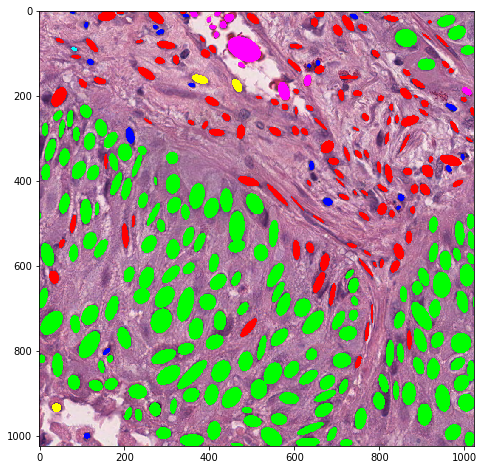

In [25]:
# Reconstruct segmentation
h, w = 1024, 1024
# mycolors = np.array(["lime", "red", "blue", "magenta", "yellow", "cyan"])
mycolors = np.array([[0, 255, 0], [255, 0, 0], [0, 0, 255], [255, 0, 255], [255, 255, 0], [0, 255, 255]])
roi_pred_image = image.copy()
for index, (_, cell) in enumerate(patch_summary.iterrows()):
    y, x = skimage.draw.ellipse(cell['coordinate_x'] - patch_coords['coordinate_x'][patch_id], 
                                cell['coordinate_y'] - patch_coords['coordinate_y'][patch_id], 
                                cell['major_axis_length']/2, cell['minor_axis_length']/2, 
                                rotation=-cell['orientation'])
    c = np.logical_and.reduce([x>0, x<h, y>0, y<w])
    x, y = x[c], y[c]
    roi_pred_image[x, y, :] = mycolors[int(cell['cell_type'] - 1)]
    
plt.figure(figsize=(8, 8))
plt.imshow(roi_pred_image)
plt.show()

In [26]:
model_re = NucleiNetRe(11, 2, batch=False)
model_re.to(device)
model_re.load_state_dict(
        torch.load("./models/cell_graph_ADC_vs_SCC_2_11042019/epoch_285.pt",
        map_location=device),
    strict=True)
model_re.eval()

from torch import optim
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model_re.parameters(), 
                      lr=0.001, 
                      momentum=0.9,
                      weight_decay=0.005)
data.x.requires_grad_(True)
data.edge_attr.requires_grad_(True)
grad_edge = []
# data.x.register_hook(lambda grad: print(grad))
data.edge_attr.register_hook(lambda grad: grad_edge.append(grad))

# For gradients of parameters in model
# def hookFunc(module, gradInput, gradOutput):
#     print(len(gradInput))
#     for v in gradInput:
#         print(v)
# model_re.conv1.register_backward_hook(hookFunc)

# Forward and backward
outputs = model_re(data.to(device))
loss = criterion(outputs[None, :], torch.tensor([0]))
optimizer.zero_grad()
loss.backward()
optimizer.step()

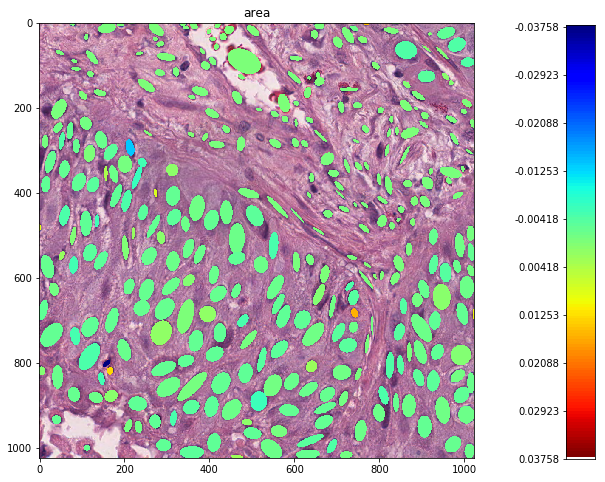

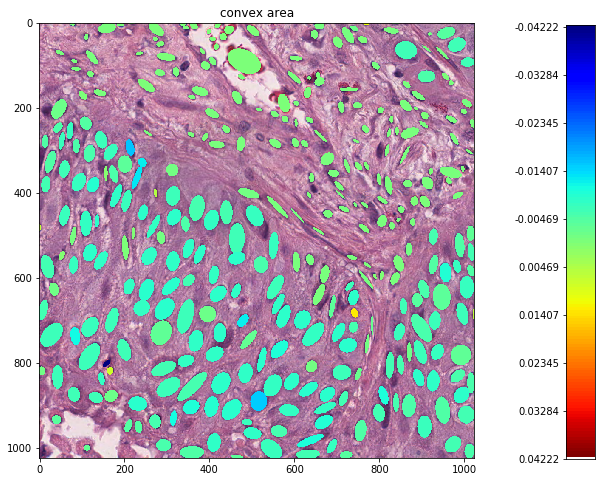

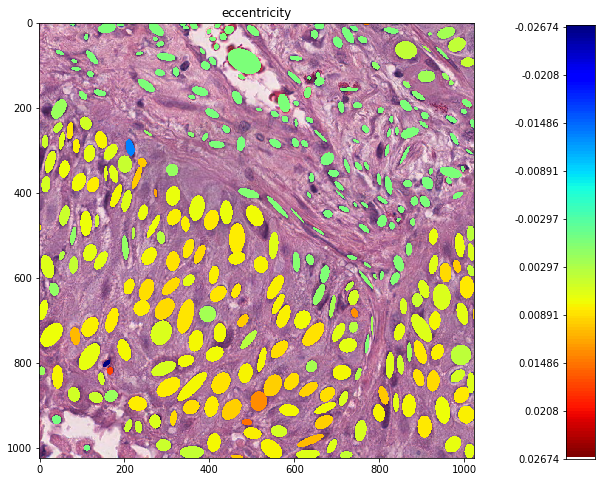

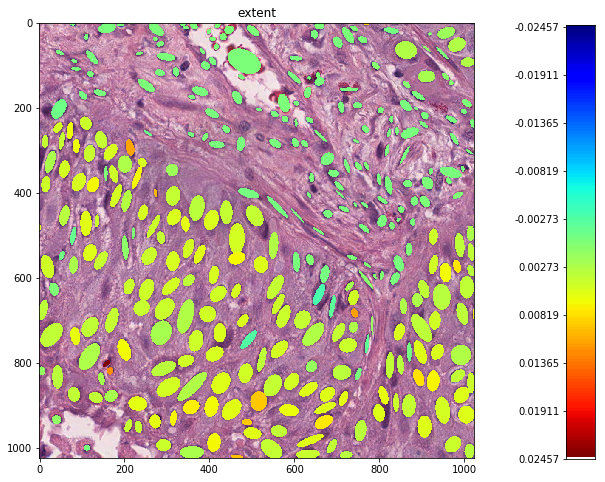

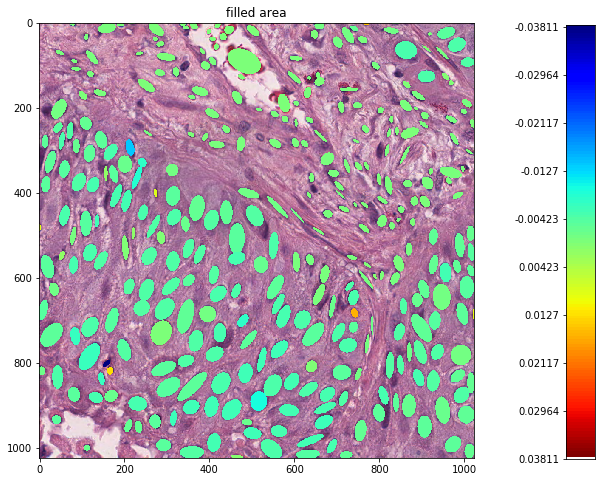

...

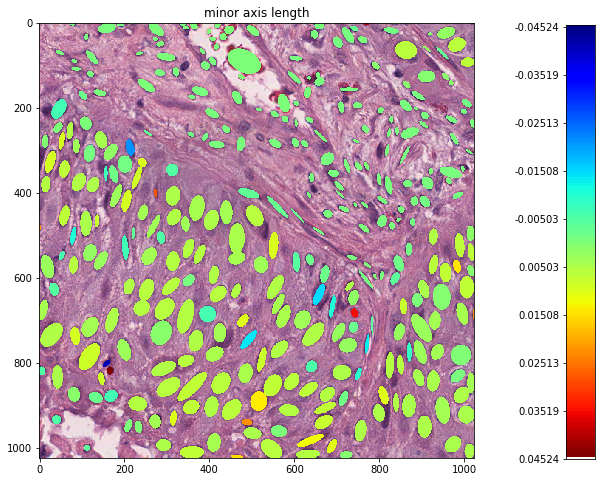

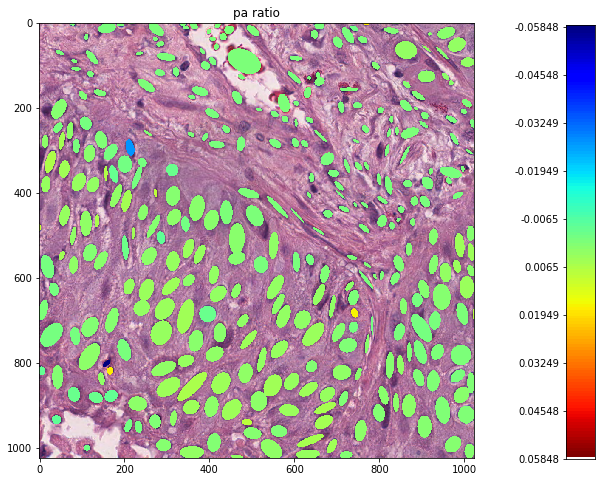

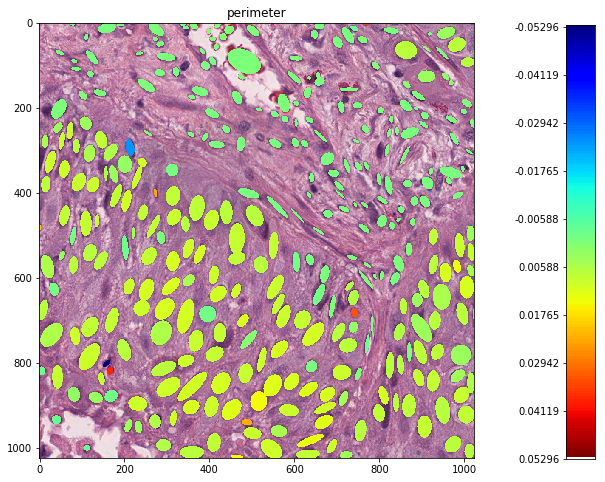

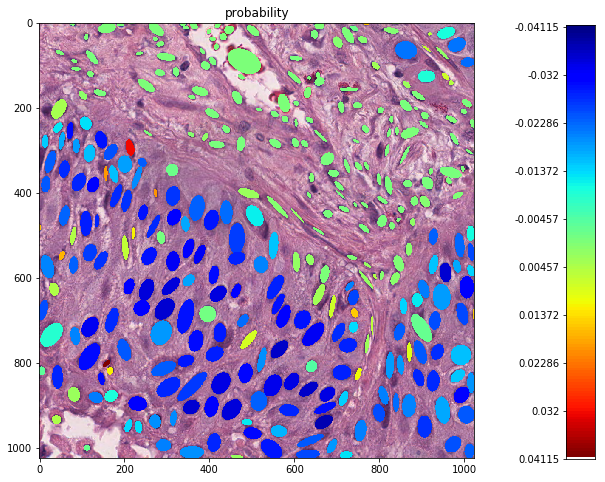

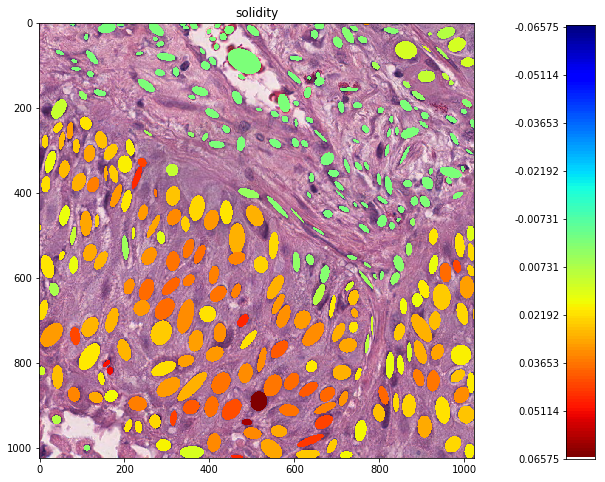

In [27]:
# Plot gradient of data.x
x_feature_names = ["area", "convex area", "eccentricity", 
                     "extent", "filled area", "major axix length", 
                     "minor axis length", "pa ratio", "perimeter", "probability", 
                     "solidity"]

for i in range(11):
    cell_feature_attributes = data.x.grad.numpy()[:, i]
    
    vmax = np.max(np.abs(data.x.grad.numpy()[:, i]))
    vmin = -vmax
    
    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
    cmap = cm.jet
    m = cm.ScalarMappable(norm=norm, cmap=cmap)
    mycolor_risk = m.to_rgba(cell_feature_attributes)

    # Reconstruct segmentation
    h, w = 1024, 1024
    # mycolors = np.array(["lime", "red", "blue", "magenta", "yellow", "cyan"])
    mycolors = np.array([[0, 255, 0], [255, 0, 0], [0, 0, 255], [255, 0, 255], [255, 255, 0], [0, 255, 255]])
    roi_pred_image = image.copy()
    for index, (_, cell) in enumerate(patch_summary.iterrows()):
        y, x = skimage.draw.ellipse(cell['coordinate_x'] - patch_coords['coordinate_x'][patch_id], 
                                    cell['coordinate_y'] - patch_coords['coordinate_y'][patch_id], 
                                    cell['major_axis_length']/2, cell['minor_axis_length']/2, 
                                    rotation=-cell['orientation'])
        c = np.logical_and.reduce([x>0, x<h, y>0, y<w])
        x, y = x[c], y[c]
        roi_pred_image[x, y, :] = mycolor_risk[index][:3] * 255
        
#         if cell['cell_type'] == 1:
#             # Mark tumor cells
#             label_img = np.zeros((h, w), dtype=int)
#             label_img[x, y] = 1
#             roi_pred_image = np.array(skimage.segmentation.mark_boundaries(roi_pred_image, label_img, color=(1, 1, 1), 
#                                                  outline_color=None, mode='thick', background_label=0)*255, dtype=np.uint8)
    
    fig, ax = plt.subplots(figsize=(8, 8))
    im1 = plt.imshow(roi_pred_image)
    plt.title(x_feature_names[i])
    # Add colorbar
    colorbar = list(np.linspace(vmin, vmax, 150))*10
    colorbar = np.array(colorbar).reshape(-1, 10, order='F')
    cax = fig.add_axes([1.05, 0, 0.05, 1])
    im2 = cax.imshow(colorbar, cmap='jet')
    cax.set_xticks([])
    cax.set_xticklabels([])
    cax.set_yticks(np.linspace(colorbar.shape[0], 0, 10))
    cax.set_yticklabels(np.round(np.linspace(vmax, vmin, 10), 5))
    # End of adding colorbar
    plt.show()

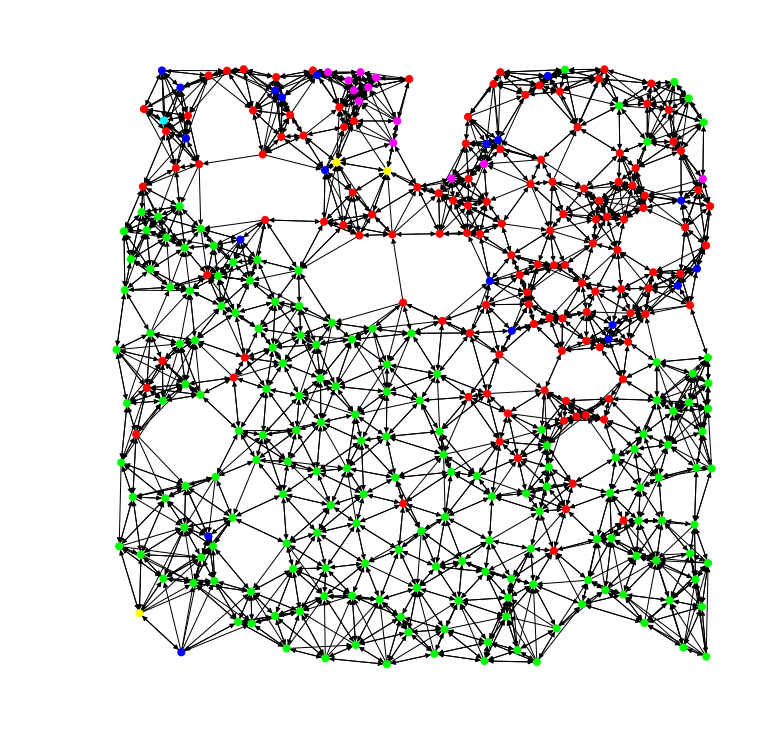

In [28]:
DG = nx.DiGraph()
DG.add_nodes_from(list(zip(np.arange(0, patch_summary.shape[0]), [dict(label=i) for i in patch_summary['cell_type'].values])))
# DG.add_weighted_edges_from(edges)

# Plot graph
plt.figure(figsize=(10, 10))
pos = {}
for i in range(patch_summary.shape[0]):
    pos[i] = [patch_summary['coordinate_x'].values[i], -patch_summary['coordinate_y'].values[i]]
nx.draw(DG, pos=pos, with_labels=False, node_color=mycolor, node_size=50, edgelist=edges)
plt.show()

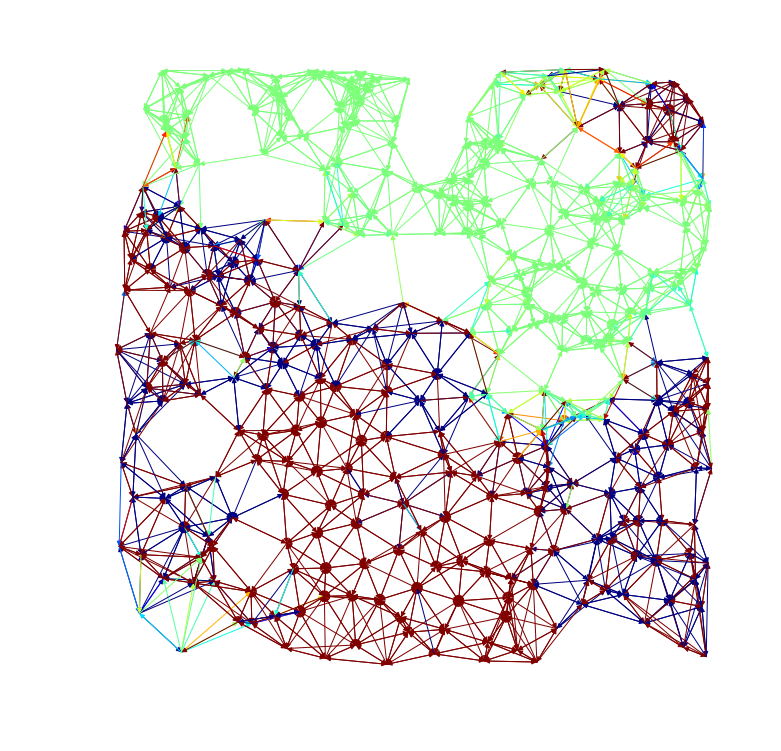

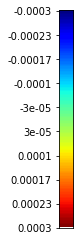

In [29]:
# Plot gradient of data.edge_attr[:, 1] (angle)
# vmin = np.min(data.edge_attr.grad.numpy()[:, 1])
# vmax = np.max(data.edge_attr.grad.numpy()[:, 1])
vmin = -0.0003
vmax = 0.0003
x_feature_names = ["distance", "angle"]

edge_feature_attributes = data.edge_attr.grad.numpy()[:, 1]

norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
cmap = cm.jet
m = cm.ScalarMappable(norm=norm, cmap=cmap)
mycolor_risk = m.to_rgba(edge_feature_attributes)

DG = nx.DiGraph()
DG.add_nodes_from(list(zip(np.arange(0, patch_summary.shape[0]), [dict(label=i) for i in patch_summary['cell_type'].values])))
# DG.add_weighted_edges_from(edges)

# Plot graph
plt.figure(figsize=(10, 10))
pos = {}
for i in range(patch_summary.shape[0]):
    pos[i] = [patch_summary['coordinate_x'].values[i], -patch_summary['coordinate_y'].values[i]]
nx.draw(DG, pos=pos, with_labels=False, node_color=mycolor, node_size=0,  # was 50
        edge_color=mycolor_risk, edgelist=edges)
plt.show()

# Plot colorbar
colorbar = list(np.linspace(vmin, vmax, 150))*10
colorbar = np.array(colorbar).reshape(-1, 10, order='F')
plt.imshow(colorbar, cmap='jet')
plt.xticks([], [])
plt.yticks(np.linspace(colorbar.shape[0], 0, 10), np.round(np.linspace(vmax, vmin, 10), 5))
plt.show()

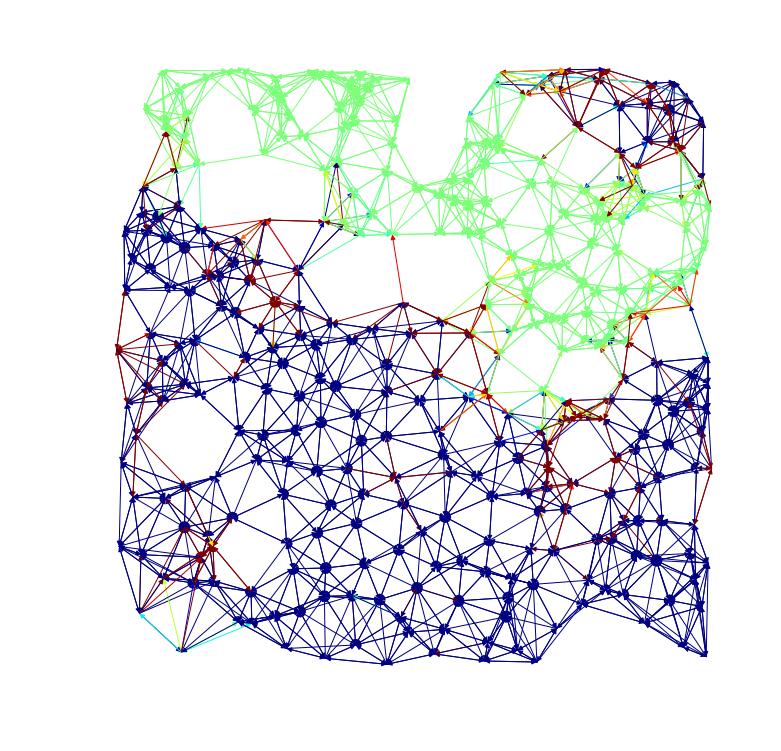

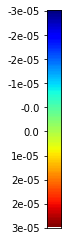

In [30]:
# Plot gradient of data.edge_attr[:, 2] (weight)
# vmin = np.min(data.edge_attr.grad.numpy()[:, 2])
# vmax = np.max(data.edge_attr.grad.numpy()[:, 2])
vmin = -0.00003
vmax = 0.00003
x_feature_names = ["distance", "angle"]

edge_feature_attributes = data.edge_attr.grad.numpy()[:, 2]

norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
cmap = cm.jet
m = cm.ScalarMappable(norm=norm, cmap=cmap)
mycolor_risk = m.to_rgba(edge_feature_attributes)

DG = nx.DiGraph()
DG.add_nodes_from(list(zip(np.arange(0, patch_summary.shape[0]), [dict(label=i) for i in patch_summary['cell_type'].values])))
# DG.add_weighted_edges_from(edges)

# Plot graph
plt.figure(figsize=(10, 10))
pos = {}
for i in range(patch_summary.shape[0]):
    pos[i] = [patch_summary['coordinate_x'].values[i], -patch_summary['coordinate_y'].values[i]]
nx.draw(DG, pos=pos, with_labels=False, node_color=mycolor, node_size=0,  # was 50
        edge_color=mycolor_risk, edgelist=edges)
plt.show()

# Plot colorbar
colorbar = list(np.linspace(vmin, vmax, 150))*10
colorbar = np.array(colorbar).reshape(-1, 10, order='F')
plt.imshow(colorbar, cmap='jet')
plt.xticks([], [])
plt.yticks(np.linspace(colorbar.shape[0], 0, 10), np.round(np.linspace(vmax, vmin, 10), 5))
plt.show()

# 3) Together for boxplot

In [80]:
cell_types_adc = []
xs_adc = []
edges_adc = []
x_gradients_adc = []
edge_gradients_adc = []

pid = 0
i = 0

for slide_id in os.listdir(nlst_adc_data_dir):
    # Read image patch & nuclei
    try:
        cell_summary = pd.read_csv(os.path.join(nlst_adc_data_dir, slide_id, "cell_summary_40X_100patches.csv"))
        found = False
        for patch_id in range(9, 29):
            if found:  # Only process 1 patch per slide
                break
            patch_summary = cell_summary[cell_summary['n_patch'] == patch_id]
            patch_coords = pd.read_csv(os.path.join(nlst_adc_data_dir, slide_id, "patch_summary_40X_100patches.csv"))

            # Plot image
            slide_file = os.path.join("/archive/DPDS/Xiao_lab/shared/hudanyun_sheng/pathology_image_data/NLST_ADC", slide_id)
            image = extract_patch_by_location(slide_file, 
                                              location=(patch_coords['coordinate_x'][patch_id], 
                                                        patch_coords['coordinate_y'][patch_id]),
                                              patch_size=(1024, 1024))
            image = np.array(image)[..., :3]

            # Plot nuclei
            coord_x, coord_y = patch_coords.loc[patch_id, ["coordinate_x", "coordinate_y"]].values
            coordinate_x = patch_summary['coordinate_x'] - patch_coords['coordinate_x'][patch_id]
            coordinate_y = patch_summary['coordinate_y'] - patch_coords['coordinate_y'][patch_id]

            mycolors = np.array(["lime", "red", "blue", "magenta", "yellow", "cyan"])
            mycolor = mycolors[patch_summary['cell_type'] - 1]

            '''
            f = plt.figure(figsize=(6, 6))
            plt.imshow(image)
            plt.scatter(coordinate_x, coordinate_y,  c=mycolor, s=20, linewidths=0)
            plt.xlim((0, 1024))
            plt.ylim((0, 1024))
            # f.savefig(fname="./writing/10857_30_centroids.pdf")
            plt.show()
            '''

            # Construct graph data
            if sum(patch_summary['cell_type'] == 1) < 20:
                # raise Exception("Too few tumor cells.")
                print("Too few tumor cells")
                continue
            else:
                found = True

            # Create 8 nearest neighbors graph
            graph = skgraph.kneighbors_graph(np.array(patch_summary.loc[:, ['coordinate_x', 'coordinate_y']]), 
                                             n_neighbors=8, mode='distance')
            I, J, V = sp.find(graph)
            edges = list(zip(I, J, 1/V))
            edge_index = np.transpose(np.array(edges)[:, 0:2])
            x = (np.array(patch_summary.loc[:, ['area', 'convex_area', 
                                               'eccentricity', 'extent', 'filled_area', 
                                                'major_axis_length', 'minor_axis_length', 'pa_ratio', 
                                                'perimeter', 'probability', 'solidity']]) - x_ave)/x_std
            cell_type = np.array(patch_summary['cell_type'])
            orientation = np.array(patch_summary['orientation'])

            # Edge features
            edge_type = list(map(lambda x: get_edge_type(x, cell_type), edges))
            nuclei_orientation = list(map(lambda x: get_nuclei_orientation_diff(x, orientation), edges))
            edge_attr = np.transpose(np.array([edge_type, nuclei_orientation, 1/V]))

            data = NucleiData(x=torch.tensor(x, dtype=torch.float), 
                              cell_type=torch.tensor(cell_type, dtype=torch.long),
                              edge_index=torch.tensor(edge_index, dtype=torch.long),
                              edge_attr=torch.tensor(edge_attr, dtype=torch.float),
                              y=torch.tensor([[0]]),
                              pid=torch.tensor([[i]]),
                              region_id=torch.tensor([[patch_id]]))

            print(slide_id, model(data.to(device)).detach().cpu().numpy().squeeze())

            model_re = NucleiNetRe(11, 2, batch=False)
            model_re.to(device)
            model_re.load_state_dict(
                    torch.load("./models/cell_graph_ADC_vs_SCC_2_11042019/epoch_285.pt",
                    map_location=device),
                strict=True)
            model_re.eval()

            from torch import optim
            criterion = nn.CrossEntropyLoss()
            optimizer = optim.SGD(model_re.parameters(), 
                                  lr=0.001, 
                                  momentum=0.9,
                                  weight_decay=0.005)
            data.x.requires_grad_(True)
            data.edge_attr.requires_grad_(True)
            grad_edge = []
            # data.x.register_hook(lambda grad: print(grad))
            data.edge_attr.register_hook(lambda grad: grad_edge.append(grad))

            # For gradients of parameters in model
            # def hookFunc(module, gradInput, gradOutput):
            #     print(len(gradInput))
            #     for v in gradInput:
            #         print(v)
            # model_re.conv1.register_backward_hook(hookFunc)

            # Forward and backward
            outputs = model_re(data.to(device))
            loss = criterion(outputs[None, :], torch.tensor([0]))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            ## Get x & edge gradient
            cell_types_adc.append(data.cell_type)
            xs_adc.append(data.x)
            edges_adc.append(data.edge_attr)
            x_gradients_adc.append(data.x.grad)
            edge_gradients_adc.append(data.edge_attr.grad)
    except Exception as e:
        print(e)

11259.svs [12.933646 10.166021]
9528.svs [13.754303   7.1422963]
Too few tumor cells
Too few tumor cells
Too few tumor cells
10500.svs [17.320679  6.202422]
10672.svs [6.4486704 5.0693955]
Too few tumor cells
Too few tumor cells
11458.svs [14.805805  8.816218]
File b'/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated/NLSI0000163.svs/cell_summary_40X_100patches.csv' does not exist
11786.svs [13.933733 10.082147]
File b'/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated/NLSI0000253.svs/cell_summary_40X_100patches.csv' does not exist
10639.svs [10.150542   7.3509483]
Too few tumor cells
Too few tumor cells
Too few tumor cells
Too few tumor cells
Too few tumor cells
Too few tumor cells
9776.svs [16.866198  6.682889]
9740.svs [8.207092  6.0062966]
Too few tumor cells
Too few tumor cells
Too few tumor cells
Too few tumor cells
Too few tumor cells
Too few tumor cells
Too few tumor cel

10640.svs [10.302477  6.395026]
File b'/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated/NLSI0000152.svs/cell_summary_40X_100patches.csv' does not exist
10046.svs [3.6720526 3.992476 ]
11372.svs [12.337167   6.3710027]
File b'/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated/NLSI0000294.svs/cell_summary_40X_100patches.csv' does not exist
10619.svs [11.090226   6.8972397]
File b'/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated/NLSI0000293.svs/cell_summary_40X_100patches.csv' does not exist
11031.svs [8.580592  7.3440065]
11004.svs [11.787242  7.687078]
9544.svs [16.709759   5.5098557]
File b'/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated/NLSI0000184.svs/cell_summary_40X_100patches.csv' does not exist
9530.svs [10.606349   5.7863374]
Too few tumor cells
11342.svs 

9965.svs [3.4633296 8.86515  ]
11240.svs [9.33579   6.1376276]
11460.svs [9.179425  7.1340427]
10461.svs [9.0652   6.307522]
10374.svs [15.024995   7.6492906]
10905.svs [11.361732   6.3535233]
9966.svs [11.719477   6.1852994]
11030.svs [11.690667  8.923449]
11003.svs [9.497409  7.8998017]
Too few tumor cells
11368.svs [11.918491  6.857719]
11351.svs [14.684262  6.537637]
11191.svs [16.643602  5.559243]
11346.svs [11.406284  9.656157]
11388.svs [13.256622  6.598115]
File b'/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated/NLSI0000110.svs/cell_summary_40X_100patches.csv' does not exist
Too few tumor cells
9689.svs [13.334894   5.9630632]
10904.svs [13.10022    7.4367547]
Too few tumor cells
11352.svs [11.9386425  5.8840246]
File b'/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated/NLSI0000100.svs/cell_summary_40X_100patches.csv' does not exist
11373.svs [12.350719   7.2639365]
1

11233.svs [6.162099  7.3868794]
File b'/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated/NLSI0000055.svs/cell_summary_40X_100patches.csv' does not exist
Too few tumor cells
11432.svs [7.5829735 6.269989 ]
11398.svs [8.337703  7.3109646]
10505.svs [12.770384  8.6409  ]
11026.svs [15.412198  6.877029]
10880.svs [14.497957  4.976337]
10674.svs [5.9959693 7.8906465]
11106.svs [9.820271 8.093926]
11218.svs [11.900144 10.522951]
9738.svs [11.413915   6.7349787]
11463.svs [7.5829053 7.1089187]
Too few tumor cells
11253.svs [10.590438  8.307895]
10409.svs [11.175471   7.1035547]
File b'/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated/NLSI0000029.svs/cell_summary_40X_100patches.csv' does not exist
File b'/project/DPDS/Xiao_lab/shared/deep_learning_SW_RR/nuclei_segmentation/output/NLST_ADC_100_patches_updated/NLSI0000212.svs/cell_summary_40X_100patches.csv' does not exist
11229.svs [1

In [ ]:
cell_types_scc = []
xs_scc = []
edges_scc = []
x_gradients_scc = []
edge_gradients_scc = []

pid = 0
i = 0

for slide_id in os.listdir(nlst_scc_data_dir):
    # Read image patch & nuclei
    try:
        cell_summary = pd.read_csv(os.path.join(nlst_scc_data_dir, slide_id, "cell_summary_40X_100patches.csv"))
        found = False
        for patch_id in range(9, 29):
            if found:  # Only process 1 patch per slide
                break
            patch_summary = cell_summary[cell_summary['which_patch'] == patch_id]
            patch_coords = pd.read_csv(os.path.join(nlst_scc_data_dir, slide_id, "patch_summary_40X_100patches.csv"))

            # Plot image
            slide_file = os.path.join(nlst_scc_slide_dir, slide_id)
            image = extract_patch_by_location(slide_file, 
                                              location=(patch_coords['coordinate_x'][patch_id], 
                                                        patch_coords['coordinate_y'][patch_id]),
                                              patch_size=(1024, 1024))
            image = np.array(image)[..., :3]

            # Plot nuclei
            coord_x, coord_y = patch_coords.loc[patch_id, ["coordinate_x", "coordinate_y"]].values
            coordinate_x = patch_summary['coordinate_x'] - patch_coords['coordinate_x'][patch_id]
            coordinate_y = patch_summary['coordinate_y'] - patch_coords['coordinate_y'][patch_id]

            mycolors = np.array(["lime", "red", "blue", "magenta", "yellow", "cyan"])
            mycolor = mycolors[patch_summary['cell_type'] - 1]

            '''
            f = plt.figure(figsize=(6, 6))
            plt.imshow(image)
            plt.scatter(coordinate_x, coordinate_y,  c=mycolor, s=20, linewidths=0)
            plt.xlim((0, 1024))
            plt.ylim((0, 1024))
            # f.savefig(fname="./writing/10857_30_centroids.pdf")
            plt.show()
            '''

            # Construct graph data
            if sum(patch_summary['cell_type'] == 1) < 20:
                # raise Exception("Too few tumor cells.")
                print("Too few tumor cells")
                continue
            else:
                found = True

            # Create 8 nearest neighbors graph
            graph = skgraph.kneighbors_graph(np.array(patch_summary.loc[:, ['coordinate_x', 'coordinate_y']]), 
                                             n_neighbors=8, mode='distance')
            I, J, V = sp.find(graph)
            edges = list(zip(I, J, 1/V))
            edge_index = np.transpose(np.array(edges)[:, 0:2])
            x = (np.array(patch_summary.loc[:, ['area', 'convex_area', 
                                               'eccentricity', 'extent', 'filled_area', 
                                                'major_axis_length', 'minor_axis_length', 'pa_ratio', 
                                                'perimeter', 'probability', 'solidity']]) - x_ave)/x_std
            cell_type = np.array(patch_summary['cell_type'])
            orientation = np.array(patch_summary['orientation'])

            # Edge features
            edge_type = list(map(lambda x: get_edge_type(x, cell_type), edges))
            nuclei_orientation = list(map(lambda x: get_nuclei_orientation_diff(x, orientation), edges))
            edge_attr = np.transpose(np.array([edge_type, nuclei_orientation, 1/V]))

            data = NucleiData(x=torch.tensor(x, dtype=torch.float), 
                              cell_type=torch.tensor(cell_type, dtype=torch.long),
                              edge_index=torch.tensor(edge_index, dtype=torch.long),
                              edge_attr=torch.tensor(edge_attr, dtype=torch.float),
                              y=torch.tensor([[0]]),
                              pid=torch.tensor([[i]]),
                              region_id=torch.tensor([[patch_id]]))

            # data.x = torch.zeros_like(data.x) + 1

            print(slide_id, model(data.to(device)).detach().cpu().numpy().squeeze())

            model_re = NucleiNetRe(11, 2, batch=False)
            model_re.to(device)
            model_re.load_state_dict(
                    torch.load("./models/cell_graph_ADC_vs_SCC_2_11042019/epoch_285.pt",
                    map_location=device),
                strict=True)
            model_re.eval()

            from torch import optim
            criterion = nn.CrossEntropyLoss()
            optimizer = optim.SGD(model_re.parameters(), 
                                  lr=0.001, 
                                  momentum=0.9,
                                  weight_decay=0.005)
            data.x.requires_grad_(True)
            data.edge_attr.requires_grad_(True)
            grad_edge = []
            # data.x.register_hook(lambda grad: print(grad))
            data.edge_attr.register_hook(lambda grad: grad_edge.append(grad))

            # For gradients of parameters in model
            # def hookFunc(module, gradInput, gradOutput):
            #     print(len(gradInput))
            #     for v in gradInput:
            #         print(v)
            # model_re.conv1.register_backward_hook(hookFunc)

            # Forward and backward
            outputs = model_re(data.to(device))
            loss = criterion(outputs[None, :], torch.tensor([0]))
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            ## Get x & edge gradient
            cell_types_scc.append(data.cell_type)
            xs_scc.append(data.x)
            edges_scc.append(data.edge_attr)
            x_gradients_scc.append(data.x.grad)
            edge_gradients_scc.append(data.edge_attr.grad)
    except Exception as e:
        print(e)

## Scatter plot for both ADC and SCC

1 vs. 2: Ttest_indResult(statistic=5.434299319536553, pvalue=5.524204016014258e-08)
2 vs. 3: Ttest_indResult(statistic=23.768517514291684, pvalue=2.4772693175870115e-124)
3 vs. 4: Ttest_indResult(statistic=-8.70224117262595, pvalue=3.3635863605627306e-18)
4 vs. 5: Ttest_indResult(statistic=0.8715592162948458, pvalue=0.38347524984889203)
5 vs. 6: Ttest_indResult(statistic=0.558768567456309, pvalue=0.5763650727932018)
1 vs. 0 Ttest_1sampResult(statistic=7.847608692268076, pvalue=4.37732859215272e-15)
2 vs. 0 Ttest_1sampResult(statistic=14.536126070658607, pvalue=1.1198255528437276e-47)
3 vs. 0 Ttest_1sampResult(statistic=-27.412100675823588, pvalue=7.41649078228255e-164)
4 vs. 0 Ttest_1sampResult(statistic=-5.095354368547455, pvalue=3.590199775007656e-07)
5 vs. 0 Ttest_1sampResult(statistic=-7.410379626920279, pvalue=1.8184733877609864e-13)
6 vs. 0 Ttest_1sampResult(statistic=-1.8894735440747539, pvalue=0.059262504446572314)


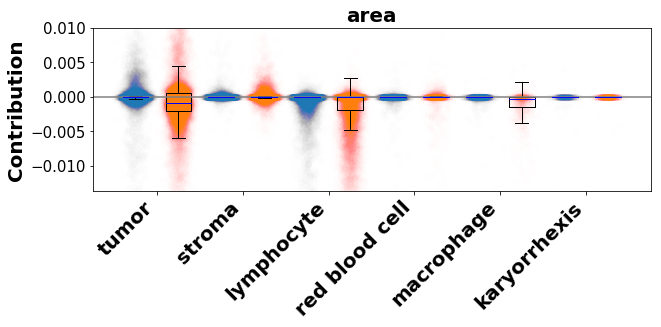

1 vs. 2: Ttest_indResult(statistic=-0.29885835878252637, pvalue=0.765049464691717)
2 vs. 3: Ttest_indResult(statistic=56.56867240236206, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=-1.6832230741533294, pvalue=0.09233958596340323)
4 vs. 5: Ttest_indResult(statistic=26.197697012064822, pvalue=2.9678038780418877e-144)
5 vs. 6: Ttest_indResult(statistic=-4.249083248813744, pvalue=2.208732730855605e-05)
1 vs. 0 Ttest_1sampResult(statistic=-3.71447782909441, pvalue=0.00020413103197746741)
2 vs. 0 Ttest_1sampResult(statistic=18.869851797670318, pvalue=1.5422160586013311e-78)
3 vs. 0 Ttest_1sampResult(statistic=-52.078923760768994, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-5.805089545457886, pvalue=7.3653145579790606e-09)
5 vs. 0 Ttest_1sampResult(statistic=-15.603716374934775, pvalue=2.6070949406285728e-49)
6 vs. 0 Ttest_1sampResult(statistic=-1.7328678445112944, pvalue=0.08341054816866132)
class 1 ADC vs. SCC Ttest_indResult(statistic=6.723928022067928, pvalue=1.7869195038351308e-1

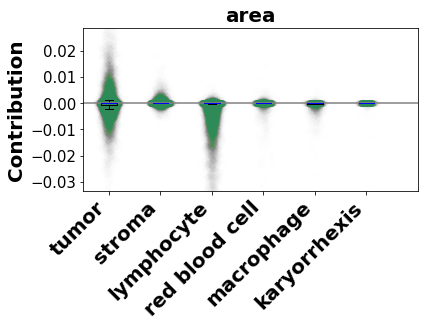

Summarized comparison
1 vs. 2: Ttest_indResult(statistic=-2.760500802466789, pvalue=0.0057724115453513265)
2 vs. 3: Ttest_indResult(statistic=49.60261317807653, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=-18.781149704411757, pvalue=1.7019449756314931e-78)
4 vs. 5: Ttest_indResult(statistic=10.98440610953999, pvalue=6.315952077656044e-28)
5 vs. 6: Ttest_indResult(statistic=-9.869871632009227, pvalue=9.231322357377664e-23)
1 vs. 0 Ttest_1sampResult(statistic=-0.1877003425177212, pvalue=0.8511122858324439)
2 vs. 0 Ttest_1sampResult(statistic=23.107449696079566, pvalue=2.2512064030211133e-117)
3 vs. 0 Ttest_1sampResult(statistic=-57.372907111583864, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-7.675998039094466, pvalue=1.8339571142828494e-14)
5 vs. 0 Ttest_1sampResult(statistic=-16.05150552046961, pvalue=9.354328134731696e-56)
6 vs. 0 Ttest_1sampResult(statistic=-2.2044406063831743, pvalue=0.027624981595195667)
End of Summarized comparison
1 vs. 2: Ttest_indResult(statistic=-22.661

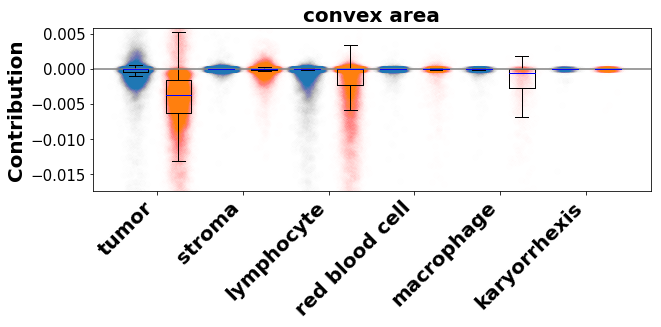

1 vs. 2: Ttest_indResult(statistic=-11.23699764112794, pvalue=2.9288426086430925e-29)
2 vs. 3: Ttest_indResult(statistic=57.095594415506845, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=3.5896872655504852, pvalue=0.0003314639702198722)
4 vs. 5: Ttest_indResult(statistic=32.00982837220683, pvalue=1.1927685936523849e-209)
5 vs. 6: Ttest_indResult(statistic=-5.7991654186303965, pvalue=7.32460914330267e-09)
1 vs. 0 Ttest_1sampResult(statistic=-80.45230091076135, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=-22.698747729792103, pvalue=3.1412806221442116e-112)
3 vs. 0 Ttest_1sampResult(statistic=-53.381371560322435, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-10.527030826886733, pvalue=2.5659194722860437e-25)
5 vs. 0 Ttest_1sampResult(statistic=-17.554665329660406, pvalue=2.259862657692748e-60)
6 vs. 0 Ttest_1sampResult(statistic=-2.110012200457925, pvalue=0.035091614475191504)
class 1 ADC vs. SCC Ttest_indResult(statistic=79.06986059211073, pvalue=0.0)
class 2 ADC vs. SCC Ttest_in

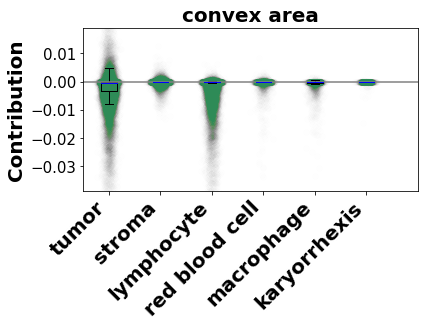

Summarized comparison
1 vs. 2: Ttest_indResult(statistic=-67.1535764396509, pvalue=0.0)
2 vs. 3: Ttest_indResult(statistic=45.612069237868, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=-17.252838918107262, pvalue=1.4762709096291012e-66)
4 vs. 5: Ttest_indResult(statistic=13.27076390003704, pvalue=6.864453072629556e-40)
5 vs. 6: Ttest_indResult(statistic=-11.926616630288057, pvalue=2.4421998602902413e-32)
1 vs. 0 Ttest_1sampResult(statistic=-79.60285646828446, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=-23.939286224305587, pvalue=8.994552816678149e-126)
3 vs. 0 Ttest_1sampResult(statistic=-59.07963874134042, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-12.689466248965516, pvalue=1.5127385026436426e-36)
5 vs. 0 Ttest_1sampResult(statistic=-18.112454792696067, pvalue=9.019781072334938e-70)
6 vs. 0 Ttest_1sampResult(statistic=-2.428467267987731, pvalue=0.015264421276362907)
End of Summarized comparison
1 vs. 2: Ttest_indResult(statistic=38.40143012812563, pvalue=0.0)
2 vs. 3: Tt

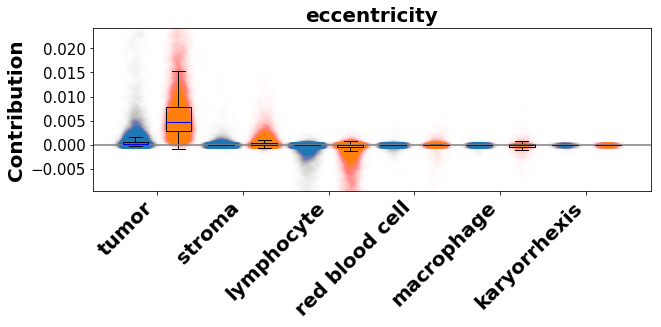

1 vs. 2: Ttest_indResult(statistic=14.262864973860397, pvalue=4.67108824761156e-46)
2 vs. 3: Ttest_indResult(statistic=46.41133018833004, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=-2.177533814782608, pvalue=0.0294464858595997)
4 vs. 5: Ttest_indResult(statistic=5.978733533238898, pvalue=2.3618108344017994e-09)
5 vs. 6: Ttest_indResult(statistic=-1.942595748409049, pvalue=0.05215408144896114)
1 vs. 0 Ttest_1sampResult(statistic=125.02910745612901, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=50.07826363267595, pvalue=0.0)
3 vs. 0 Ttest_1sampResult(statistic=-41.70579740132739, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-3.588914964978067, pvalue=0.00033932085776560626)
5 vs. 0 Ttest_1sampResult(statistic=-5.663390220104725, pvalue=1.9370630359761726e-08)
6 vs. 0 Ttest_1sampResult(statistic=-1.1956691539877817, pvalue=0.23209360699188875)
class 1 ADC vs. SCC Ttest_indResult(statistic=-115.98437443780679, pvalue=0.0)
class 2 ADC vs. SCC Ttest_indResult(statistic=-50.980065594

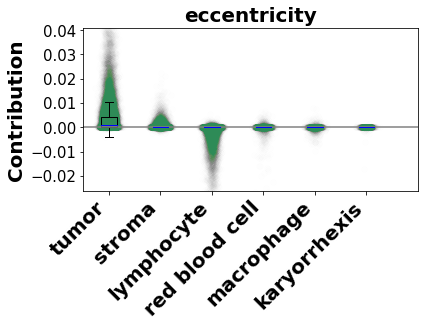

Summarized comparison
1 vs. 2: Ttest_indResult(statistic=96.20572046575471, pvalue=0.0)
2 vs. 3: Ttest_indResult(statistic=49.94418230374936, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=-15.266740314441355, pvalue=1.5566596670938974e-52)
4 vs. 5: Ttest_indResult(statistic=0.5587194090014153, pvalue=0.5763644591932802)
5 vs. 6: Ttest_indResult(statistic=-3.0927699391691186, pvalue=0.0019943198172504817)
1 vs. 0 Ttest_1sampResult(statistic=118.21731331986376, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=53.16740546613663, pvalue=0.0)
3 vs. 0 Ttest_1sampResult(statistic=-47.18710676014617, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-5.950807747408636, pvalue=2.779937297226867e-09)
5 vs. 0 Ttest_1sampResult(statistic=-6.4197945722274135, pvalue=1.573642586008536e-10)
6 vs. 0 Ttest_1sampResult(statistic=-2.4339445577776386, pvalue=0.015036181687975525)
End of Summarized comparison
1 vs. 2: Ttest_indResult(statistic=39.894447738619704, pvalue=0.0)
2 vs. 3: Ttest_indResult(statisti

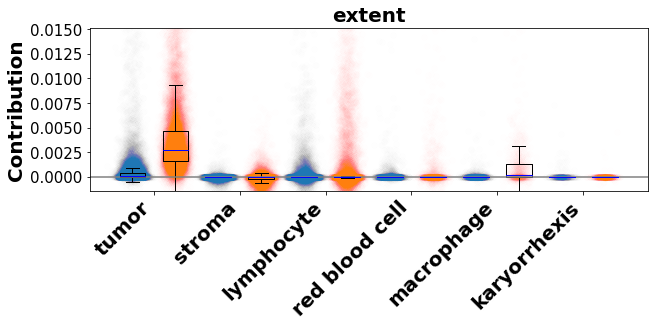

1 vs. 2: Ttest_indResult(statistic=39.631800350891126, pvalue=0.0)
2 vs. 3: Ttest_indResult(statistic=-36.40602954319812, pvalue=3.598468850614255e-286)
3 vs. 4: Ttest_indResult(statistic=-9.510587915676917, pvalue=1.9956581004934453e-21)
4 vs. 5: Ttest_indResult(statistic=-21.373700802490053, pvalue=3.564591217183637e-98)
5 vs. 6: Ttest_indResult(statistic=4.78937700147829, pvalue=1.7502743846295045e-06)
1 vs. 0 Ttest_1sampResult(statistic=111.67483569210165, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=-28.610822358345928, pvalue=1.8026413515423022e-175)
3 vs. 0 Ttest_1sampResult(statistic=33.17137616518771, pvalue=2.1845465240813922e-235)
4 vs. 0 Ttest_1sampResult(statistic=9.424263349040613, pvalue=1.0579855684503694e-20)
5 vs. 0 Ttest_1sampResult(statistic=14.598259844716804, pvalue=6.489510769428603e-44)
6 vs. 0 Ttest_1sampResult(statistic=0.37358920700686626, pvalue=0.7087848103715467)
class 1 ADC vs. SCC Ttest_indResult(statistic=-105.621449758486, pvalue=0.0)
class 2 ADC vs

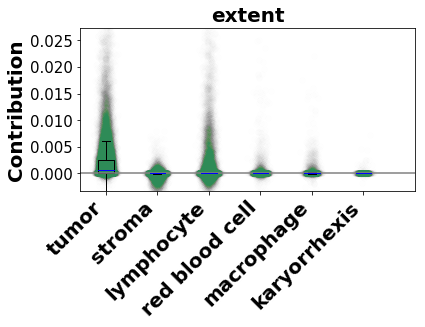

Summarized comparison
1 vs. 2: Ttest_indResult(statistic=98.37316171363881, pvalue=0.0)
2 vs. 3: Ttest_indResult(statistic=-35.9255626018856, pvalue=7.452331816614379e-281)
3 vs. 4: Ttest_indResult(statistic=7.571128225462667, pvalue=3.7463670174729145e-14)
4 vs. 5: Ttest_indResult(statistic=-5.5504757150052315, pvalue=2.914109046563524e-08)
5 vs. 6: Ttest_indResult(statistic=8.539057680761733, pvalue=1.791314528616056e-17)
1 vs. 0 Ttest_1sampResult(statistic=108.35070468033283, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=-31.332007246863064, pvalue=6.095719448639968e-213)
3 vs. 0 Ttest_1sampResult(statistic=37.34585002234459, pvalue=8.641408644952074e-302)
4 vs. 0 Ttest_1sampResult(statistic=12.266513449922838, pvalue=2.7703702853124688e-34)
5 vs. 0 Ttest_1sampResult(statistic=15.209982908673284, pvalue=1.9357005664510275e-50)
6 vs. 0 Ttest_1sampResult(statistic=2.1419051679802736, pvalue=0.032340791903003166)
End of Summarized comparison
1 vs. 2: Ttest_indResult(statistic=-4.9580

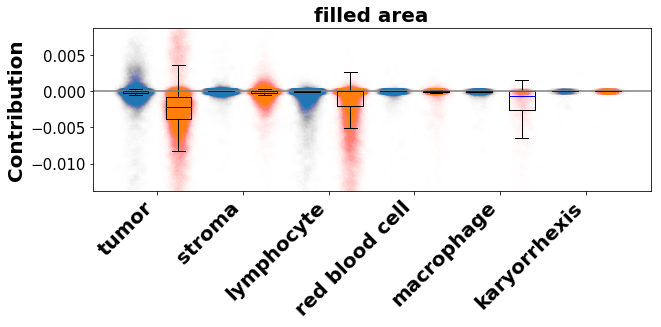

1 vs. 2: Ttest_indResult(statistic=5.4350202708776365, pvalue=5.506673593426948e-08)
2 vs. 3: Ttest_indResult(statistic=56.48814671015164, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=3.5158800008773214, pvalue=0.0004387756098276007)
4 vs. 5: Ttest_indResult(statistic=33.395782953799106, pvalue=1.084375845297906e-226)
5 vs. 6: Ttest_indResult(statistic=-5.402521744265381, pvalue=7.060134943969562e-08)
1 vs. 0 Ttest_1sampResult(statistic=-37.64504517957842, pvalue=1.5382078451761114e-300)
2 vs. 0 Ttest_1sampResult(statistic=-26.286822986548135, pvalue=5.056488480371783e-149)
3 vs. 0 Ttest_1sampResult(statistic=-52.95927728672217, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-10.421620955742377, pvalue=7.413892617281165e-25)
5 vs. 0 Ttest_1sampResult(statistic=-18.395078515969917, pvalue=2.3765238594823546e-65)
6 vs. 0 Ttest_1sampResult(statistic=-2.900188272827186, pvalue=0.0038065240888438493)
class 1 ADC vs. SCC Ttest_indResult(statistic=38.67397549262872, pvalue=0.0)
class 2 ADC

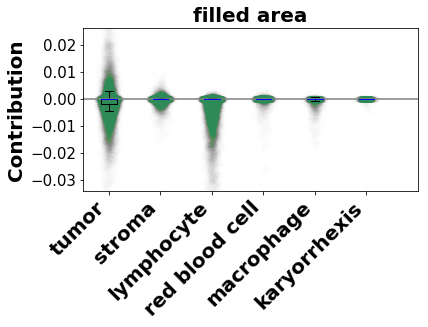

Summarized comparison
1 vs. 2: Ttest_indResult(statistic=-28.189156445306544, pvalue=4.310519824724865e-174)
2 vs. 3: Ttest_indResult(statistic=43.448063662743714, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=-17.14507167624444, pvalue=9.404523488701157e-66)
4 vs. 5: Ttest_indResult(statistic=13.605440301811827, pvalue=8.017364804801346e-42)
5 vs. 6: Ttest_indResult(statistic=-12.152215342909619, pvalue=1.7173215424174392e-33)
1 vs. 0 Ttest_1sampResult(statistic=-36.6462217583338, pvalue=2.4377059618939402e-290)
2 vs. 0 Ttest_1sampResult(statistic=-27.706942712507033, pvalue=2.123743395095878e-167)
3 vs. 0 Ttest_1sampResult(statistic=-58.45495638972422, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-12.546307065734679, pvalue=8.991040088718108e-36)
5 vs. 0 Ttest_1sampResult(statistic=-18.624434086285074, pvalue=1.8266904070978873e-73)
6 vs. 0 Ttest_1sampResult(statistic=-3.0765142533487357, pvalue=0.002127283503931767)
End of Summarized comparison
1 vs. 2: Ttest_indResult(statistic

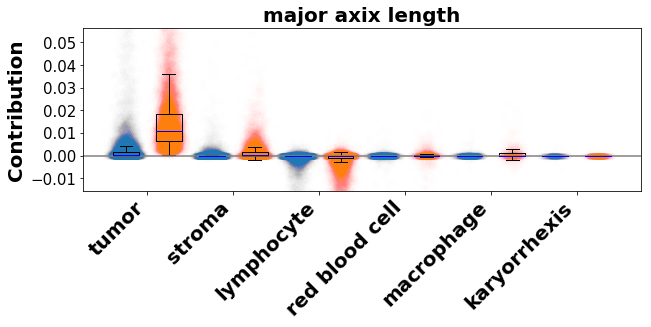

1 vs. 2: Ttest_indResult(statistic=9.148565065292901, pvalue=5.997466111256915e-20)
2 vs. 3: Ttest_indResult(statistic=50.10235591891826, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=-8.78268631361938, pvalue=1.6570631087499462e-18)
4 vs. 5: Ttest_indResult(statistic=-16.246420070449243, pvalue=2.8779468363855526e-58)
5 vs. 6: Ttest_indResult(statistic=3.5808646487442037, pvalue=0.00034763693306126455)
1 vs. 0 Ttest_1sampResult(statistic=120.21984768157348, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=53.44672744486947, pvalue=0.0)
3 vs. 0 Ttest_1sampResult(statistic=-43.82477627790478, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=3.9253322259495627, pvalue=8.927305297578222e-05)
5 vs. 0 Ttest_1sampResult(statistic=8.833100029668204, pvalue=4.467397357298141e-18)
6 vs. 0 Ttest_1sampResult(statistic=1.614935101889711, pvalue=0.1066229066439642)
class 1 ADC vs. SCC Ttest_indResult(statistic=-111.12969257078359, pvalue=0.0)
class 2 ADC vs. SCC Ttest_indResult(statistic=-53.7102541

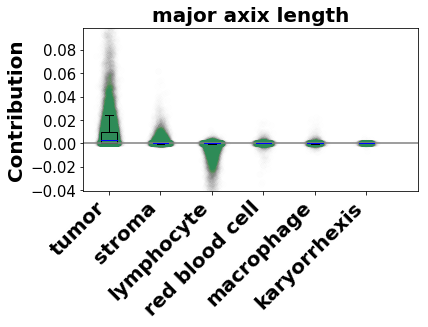

Summarized comparison
1 vs. 2: Ttest_indResult(statistic=91.22815032171204, pvalue=0.0)
2 vs. 3: Ttest_indResult(statistic=60.409057556655206, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=-18.62772633910085, pvalue=2.9812516230393105e-77)
4 vs. 5: Ttest_indResult(statistic=-7.280153539757362, pvalue=3.558990891435669e-13)
5 vs. 6: Ttest_indResult(statistic=7.158096765479586, pvalue=9.414079226827476e-13)
1 vs. 0 Ttest_1sampResult(statistic=114.96527091000394, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=56.968216210868206, pvalue=0.0)
3 vs. 0 Ttest_1sampResult(statistic=-48.948098477740096, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=3.004992994092594, pvalue=0.0026640526233841235)
5 vs. 0 Ttest_1sampResult(statistic=10.020206565426847, pvalue=2.801252958082148e-23)
6 vs. 0 Ttest_1sampResult(statistic=1.4002723934097452, pvalue=0.16161159866500105)
End of Summarized comparison
1 vs. 2: Ttest_indResult(statistic=24.885268656975605, pvalue=5.952840180328832e-136)
2 vs. 3: Ttest_

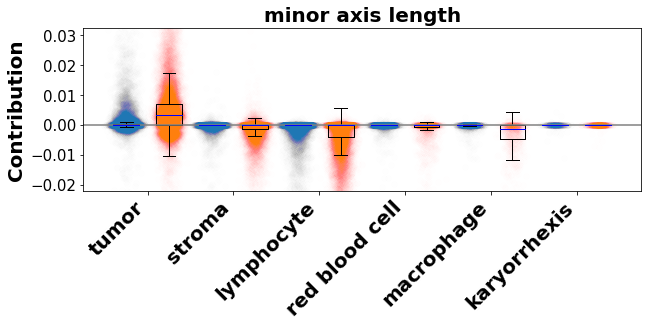

1 vs. 2: Ttest_indResult(statistic=41.62795353892849, pvalue=0.0)
2 vs. 3: Ttest_indResult(statistic=60.593700499623466, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=9.6901477455411, pvalue=3.509024372598689e-22)
4 vs. 5: Ttest_indResult(statistic=36.1911595158613, pvalue=1.3052954528321628e-262)
5 vs. 6: Ttest_indResult(statistic=-6.303941807027018, pvalue=3.306439919854125e-10)
1 vs. 0 Ttest_1sampResult(statistic=56.90280633298088, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=-46.196360704943615, pvalue=0.0)
3 vs. 0 Ttest_1sampResult(statistic=-59.43749372608196, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-15.608796515485595, pvalue=3.595858985797936e-52)
5 vs. 0 Ttest_1sampResult(statistic=-18.559458960351982, pvalue=2.447541767775644e-66)
6 vs. 0 Ttest_1sampResult(statistic=-3.1973613262026204, pvalue=0.0014280306716399468)
class 1 ADC vs. SCC Ttest_indResult(statistic=-53.253322324888295, pvalue=0.0)
class 2 ADC vs. SCC Ttest_indResult(statistic=48.22952131406399, pvalue

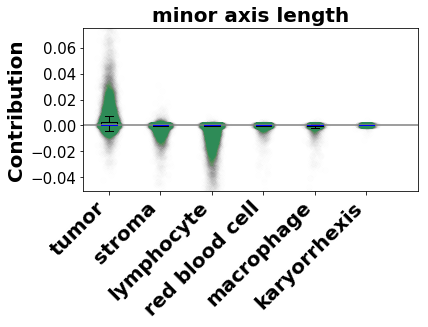

Summarized comparison
1 vs. 2: Ttest_indResult(statistic=62.71960237258637, pvalue=0.0)
2 vs. 3: Ttest_indResult(statistic=32.62248206857891, pvalue=3.243049466093575e-232)
3 vs. 4: Ttest_indResult(statistic=-17.12749340450689, pvalue=1.2706825293076279e-65)
4 vs. 5: Ttest_indResult(statistic=13.204512533248797, pvalue=1.6357067740871665e-39)
5 vs. 6: Ttest_indResult(statistic=-13.097566454685197, pvalue=1.53673570481557e-38)
1 vs. 0 Ttest_1sampResult(statistic=59.64925407405653, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=-50.51171416032141, pvalue=0.0)
3 vs. 0 Ttest_1sampResult(statistic=-65.70711789277811, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-17.913298712527652, pvalue=2.1367659035273195e-70)
5 vs. 0 Ttest_1sampResult(statistic=-19.011238058089432, pvalue=2.6129336720099673e-76)
6 vs. 0 Ttest_1sampResult(statistic=-2.3370843396392367, pvalue=0.01954868876302301)
End of Summarized comparison
1 vs. 2: Ttest_indResult(statistic=12.620413504635827, pvalue=1.8281348979461

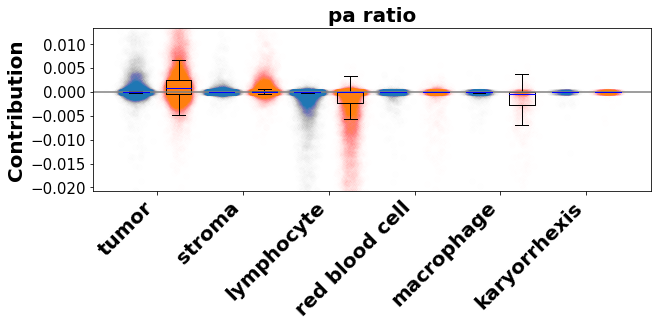

1 vs. 2: Ttest_indResult(statistic=-2.709357746448703, pvalue=0.006743845466342603)
2 vs. 3: Ttest_indResult(statistic=52.27994165478462, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=2.5893481334677704, pvalue=0.009619205655743717)
4 vs. 5: Ttest_indResult(statistic=23.64447605576132, pvalue=7.000081952710896e-119)
5 vs. 6: Ttest_indResult(statistic=-5.741617427414858, pvalue=1.0269543696144156e-08)
1 vs. 0 Ttest_1sampResult(statistic=42.03009231254885, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=32.223561341469846, pvalue=1.5470397962618488e-220)
3 vs. 0 Ttest_1sampResult(statistic=-48.15473323573538, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-8.568704041593428, pvalue=1.9375018567338706e-17)
5 vs. 0 Ttest_1sampResult(statistic=-16.257571826667387, pvalue=6.1843677221361e-53)
6 vs. 0 Ttest_1sampResult(statistic=-1.9613712272401822, pvalue=0.05009768653044363)
class 1 ADC vs. SCC Ttest_indResult(statistic=-39.31281578078682, pvalue=0.0)
class 2 ADC vs. SCC Ttest_indResult(s

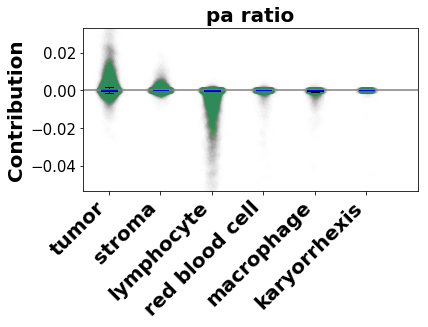

Summarized comparison
1 vs. 2: Ttest_indResult(statistic=32.781476298475994, pvalue=2.365838506865457e-234)
2 vs. 3: Ttest_indResult(statistic=48.21744217107291, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=-15.712515591533778, pvalue=1.5545504773366424e-55)
4 vs. 5: Ttest_indResult(statistic=7.881436989609147, pvalue=3.5376722088739545e-15)
5 vs. 6: Ttest_indResult(statistic=-11.021731799318799, pvalue=6.453023525657368e-28)
1 vs. 0 Ttest_1sampResult(statistic=44.37829114688894, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=34.44120307286777, pvalue=3.142953549871212e-256)
3 vs. 0 Ttest_1sampResult(statistic=-54.03119804252048, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-11.004304168739614, pvalue=5.762356100155755e-28)
5 vs. 0 Ttest_1sampResult(statistic=-17.16963010856858, pvalue=3.4607781747819235e-63)
6 vs. 0 Ttest_1sampResult(statistic=-2.6409081261065035, pvalue=0.00834304332326749)
End of Summarized comparison
1 vs. 2: Ttest_indResult(statistic=29.79690157601225, pvalu

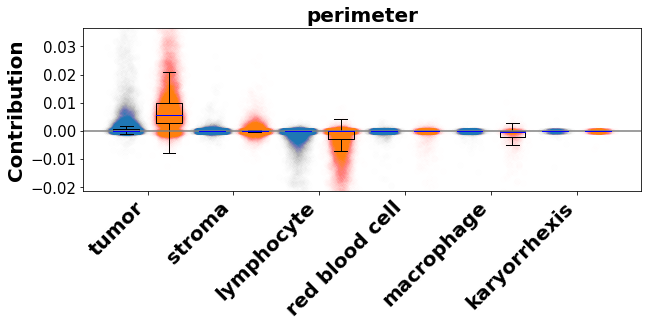

1 vs. 2: Ttest_indResult(statistic=20.262648659452417, pvalue=6.83395674738892e-91)
2 vs. 3: Ttest_indResult(statistic=55.97436466803311, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=1.143871871594009, pvalue=0.2526835062386752)
4 vs. 5: Ttest_indResult(statistic=21.716322738920436, pvalue=3.4925229276537704e-101)
5 vs. 6: Ttest_indResult(statistic=-4.242674777074013, pvalue=2.2724092616814986e-05)
1 vs. 0 Ttest_1sampResult(statistic=87.05507869299788, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=16.160825790929138, pvalue=2.8639759236905403e-58)
3 vs. 0 Ttest_1sampResult(statistic=-51.66269464385406, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-9.032635903109142, pvalue=3.5715785908596014e-19)
5 vs. 0 Ttest_1sampResult(statistic=-14.858982804619714, pvalue=2.7199569978222836e-45)
6 vs. 0 Ttest_1sampResult(statistic=-2.1722562256961195, pvalue=0.03005782780959702)
class 1 ADC vs. SCC Ttest_indResult(statistic=-80.61956008020441, pvalue=0.0)
class 2 ADC vs. SCC Ttest_indResult(

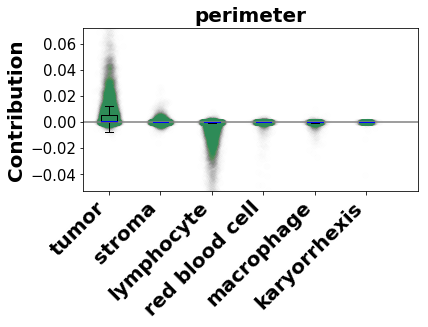

Summarized comparison
1 vs. 2: Ttest_indResult(statistic=75.35851386577387, pvalue=0.0)
2 vs. 3: Ttest_indResult(statistic=49.28621857501322, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=-17.62668075248073, pvalue=2.193125825511715e-69)
4 vs. 5: Ttest_indResult(statistic=6.369472499978054, pvalue=1.9715210618790845e-10)
5 vs. 6: Ttest_indResult(statistic=-9.694449021500319, pvalue=5.0523323962618865e-22)
1 vs. 0 Ttest_1sampResult(statistic=87.94227668465454, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=19.04722128019428, pvalue=1.5627495218790965e-80)
3 vs. 0 Ttest_1sampResult(statistic=-57.44438808022964, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=-11.130251718376163, pvalue=1.4438571720683814e-28)
5 vs. 0 Ttest_1sampResult(statistic=-15.48175812024657, pvalue=3.9496276772341765e-52)
6 vs. 0 Ttest_1sampResult(statistic=-2.214559463014432, pvalue=0.026920596324071087)
End of Summarized comparison
1 vs. 2: Ttest_indResult(statistic=-36.30237265585685, pvalue=3.205300646344895e

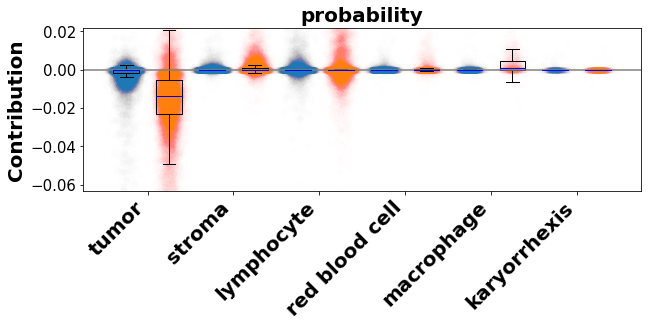

1 vs. 2: Ttest_indResult(statistic=-41.096990689021105, pvalue=0.0)
2 vs. 3: Ttest_indResult(statistic=-22.538232861508153, pvalue=6.95971602783269e-112)
3 vs. 4: Ttest_indResult(statistic=-13.300666246124388, pvalue=2.7849536246901057e-40)
4 vs. 5: Ttest_indResult(statistic=-25.487546687305606, pvalue=5.565039489161021e-137)
5 vs. 6: Ttest_indResult(statistic=5.196201243689773, pvalue=2.1636373277715252e-07)
1 vs. 0 Ttest_1sampResult(statistic=-107.43309839133684, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=38.4919909432153, pvalue=1.317552170556077e-309)
3 vs. 0 Ttest_1sampResult(statistic=23.267861309677897, pvalue=2.66708958186903e-118)
4 vs. 0 Ttest_1sampResult(statistic=10.306742560153458, pvalue=2.331029188256792e-24)
5 vs. 0 Ttest_1sampResult(statistic=15.359715363746401, pvalue=5.5720375163501e-48)
6 vs. 0 Ttest_1sampResult(statistic=0.5362344529511976, pvalue=0.5919092465349469)
class 1 ADC vs. SCC Ttest_indResult(statistic=102.2788934295428, pvalue=0.0)
class 2 ADC vs. S

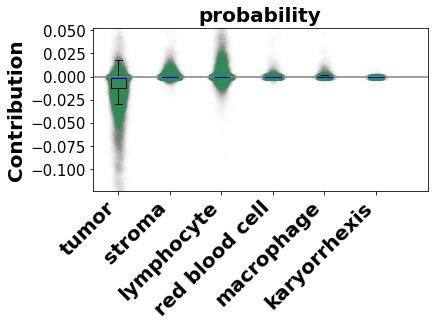

Summarized comparison
1 vs. 2: Ttest_indResult(statistic=-96.08965432040004, pvalue=0.0)
2 vs. 3: Ttest_indResult(statistic=-5.951137381030079, pvalue=2.6716353014976997e-09)
3 vs. 4: Ttest_indResult(statistic=2.80102099757143, pvalue=0.005095555189550086)
4 vs. 5: Ttest_indResult(statistic=-7.656907568319209, pvalue=2.0621517498198358e-14)
5 vs. 6: Ttest_indResult(statistic=9.750163705111515, pvalue=2.953786759305074e-22)
1 vs. 0 Ttest_1sampResult(statistic=-103.3869675500504, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=42.775032557371524, pvalue=0.0)
3 vs. 0 Ttest_1sampResult(statistic=26.69991721439096, pvalue=3.8637795878412356e-156)
4 vs. 0 Ttest_1sampResult(statistic=13.183754087800441, pvalue=2.7748570241515288e-39)
5 vs. 0 Ttest_1sampResult(statistic=16.037947991001467, pvalue=1.1443658925851845e-55)
6 vs. 0 Ttest_1sampResult(statistic=2.20396110916528, pvalue=0.027658751143749088)
End of Summarized comparison
1 vs. 2: Ttest_indResult(statistic=41.8206380323514, pvalue=0.0)

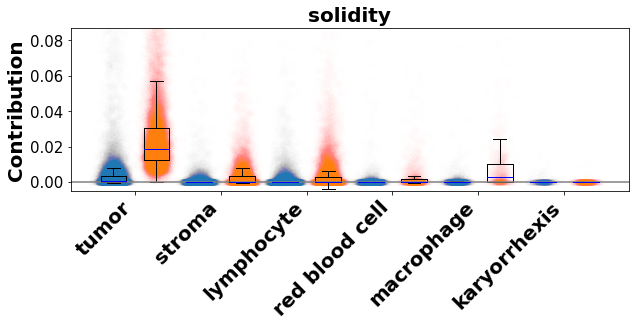

1 vs. 2: Ttest_indResult(statistic=3.9561880344679063, pvalue=7.626885149098752e-05)
2 vs. 3: Ttest_indResult(statistic=-48.736662718511084, pvalue=0.0)
3 vs. 4: Ttest_indResult(statistic=-26.89131741699265, pvalue=6.697736752620309e-158)
4 vs. 5: Ttest_indResult(statistic=-36.47609832976857, pvalue=2.2033433513050122e-266)
5 vs. 6: Ttest_indResult(statistic=5.985839842689455, pvalue=2.3953576303052837e-09)
1 vs. 0 Ttest_1sampResult(statistic=142.6949156150183, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=55.24083417661716, pvalue=0.0)
3 vs. 0 Ttest_1sampResult(statistic=52.624609317994164, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=15.942070199464293, pvalue=3.1366708366746026e-54)
5 vs. 0 Ttest_1sampResult(statistic=18.79380269610489, pvalue=9.419717121714601e-68)
6 vs. 0 Ttest_1sampResult(statistic=2.9974449347126453, pvalue=0.0027860854019744904)
class 1 ADC vs. SCC Ttest_indResult(statistic=-133.1969584240448, pvalue=0.0)
class 2 ADC vs. SCC Ttest_indResult(statistic=-56.3

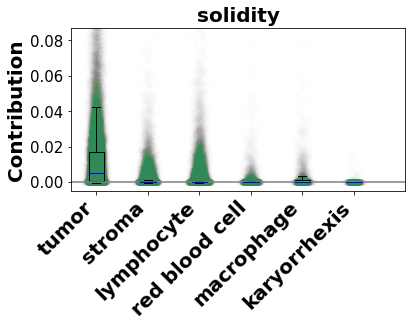

Summarized comparison
1 vs. 2: Ttest_indResult(statistic=101.11849801944932, pvalue=0.0)
2 vs. 3: Ttest_indResult(statistic=-4.207127125509078, pvalue=2.588615339897287e-05)
3 vs. 4: Ttest_indResult(statistic=7.093809139639152, pvalue=1.3173516556282916e-12)
4 vs. 5: Ttest_indResult(statistic=-13.955862516784915, pvalue=6.779689113212192e-44)
5 vs. 6: Ttest_indResult(statistic=12.424436841440947, pvalue=6.561498806056657e-35)
1 vs. 0 Ttest_1sampResult(statistic=131.1248700975983, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=59.02919379427167, pvalue=0.0)
3 vs. 0 Ttest_1sampResult(statistic=58.540293247052006, pvalue=0.0)
4 vs. 0 Ttest_1sampResult(statistic=18.63908019090879, pvalue=6.057038312817315e-76)
5 vs. 0 Ttest_1sampResult(statistic=19.189378612932806, pvalue=1.2349296599153942e-77)
6 vs. 0 Ttest_1sampResult(statistic=2.791733885108148, pvalue=0.005300438673754654)
End of Summarized comparison


In [319]:
# Box-plot with scatter
# Cell features
xticks = np.arange(1, 7)
xtick_names = ['tumor', 'stroma', 'lymphocyte', 'red blood cell', 'macrophage', 'karyorrhexis']
for feature_id, feature_name in enumerate(["area", "convex area", "eccentricity", 
                     "extent", "filled area", "major axix length", 
                     "minor axis length", "pa ratio", "perimeter", "probability", 
                     "solidity"]):
    #### ADC
    vals = [[] for _ in xticks]
    for x_grad, cell_type in zip(x_gradients_adc, cell_types_adc):
        x_grad = x_grad.detach().cpu().numpy()
        cell_type = cell_type.cpu().numpy()
        for _, xtick in enumerate(xticks):
            vals[_].extend(list(x_grad[cell_type == xtick, feature_id]))

    i = 1
    plt.figure(figsize=(10, 3))
    # plt.violinplot(vals, showmeans=False, showextrema=False)
    plt.boxplot(vals, showfliers=False, medianprops=dict(color='b'), widths=0.3)
    for val in vals:
        if i == 1:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15, val, alpha=0.002, label='ADC', c='tab:blue')
        else:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15, val, alpha=0.002, c='tab:blue')
        plt.xticks(rotation=45, ha="right")
        i += 1
    from scipy.stats import sem
    # plt.errorbar(np.arange(1, 1 + len(xticks)), [np.average(_) for _ in vals], [np.std(_) for _ in vals], 
    #              linestyle='None', marker='o', fmt='-o', c='k', elinewidth=2, capsize=10)
    # plt.ylabel('Feature value', weight='bold', fontsize=20)
    # plt.xticks(np.arange(1,  1 + len(xticks)), xtick_names, weight='bold', fontsize=20)
    # plt.yticks(fontsize=15)
    # plt.ylim(np.min([np.quantile(_, 0.1) for _ in vals]), 
    #     np.max([np.quantile(_, 0.9) for _ in vals]))
    # plt.title(feature_name, weight='bold', fontsize=20)
    # plt.axhline(0, c='gray')
    # plt.show()

    from scipy.stats import ttest_ind, ttest_1samp
    for i in range(len(vals) - 1):
        print("{} vs. {}:".format(xticks[i], xticks[i + 1]), ttest_ind(vals[i], vals[i + 1], nan_policy='omit'))
    for i in range(len(vals)):
        print("{} vs. 0".format(xticks[i]), ttest_1samp(vals[i], 0, nan_policy='omit'))
        
    #### SCC
    vals_2 = [[] for _ in xticks]
    for x_grad, cell_type in zip(x_gradients_scc, cell_types_scc):
        x_grad = x_grad.detach().cpu().numpy()
        cell_type = cell_type.cpu().numpy()
        for _, xtick in enumerate(xticks):
            vals_2[_].extend(list(x_grad[cell_type == xtick, feature_id]))

    i = 1
    # plt.violinplot(vals_2, showmeans=False, showextrema=False)
    plt.boxplot(vals_2, positions=[_ + 0.5 for _ in xticks], showfliers=False, medianprops=dict(color='b'), 
               widths=0.3)
    for val in vals_2:
        if i == 1:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15 + 0.5, val, alpha=0.002, label='SCC', c='tab:orange')
        else:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15 + 0.5, val, alpha=0.002, c='tab:orange')
        i += 1
    from scipy.stats import sem
    # plt.errorbar(np.arange(1, 1 + len(xticks)) + 0.5, [np.average(_) for _ in vals_2], [np.std(_) for _ in vals_2], 
    #              linestyle='None', marker='o', fmt='-o', c='k', elinewidth=2, capsize=10)
    
    plt.ylabel('Contribution', weight='bold', fontsize=20)
    plt.xticks(np.arange(1,  1 + len(xticks)) + 0.25, xtick_names, weight='bold', fontsize=20)
    plt.yticks(fontsize=15)
    if feature_name == "solidity":
        plt.ylim(-0.005, 
                 np.max([np.quantile(_, 0.96) for _ in vals_2]))
    else:
        plt.ylim(np.min([np.quantile(_, 0.05) for _ in vals_2]), 
                 np.max([np.quantile(_, 0.96) for _ in vals_2]))
    plt.title(feature_name, weight='bold', fontsize=20)
    plt.axhline(0, c='gray')
    plt.xlim(0.5, len(xticks) + 1)
    plt.show()

    from scipy.stats import ttest_ind, ttest_1samp
    for i in range(len(vals) - 1):
        print("{} vs. {}:".format(xticks[i], xticks[i + 1]), ttest_ind(vals[i], vals_2[i + 1], nan_policy='omit'))
    for i in range(len(vals)):
        print("{} vs. 0".format(xticks[i]), ttest_1samp(vals_2[i], 0, nan_policy='omit'))
        
    ### ADC vs. SCC comparison
    from scipy.stats import ttest_ind
    for i in range(len(vals)):
        print("class {} ADC vs. SCC".format(i + 1), ttest_ind(vals[i], vals_2[i], nan_policy='omit'))
        
    #### Combine ADC and SCC contribution together to avoid confusion
    for val, val_2 in zip(vals, vals_2):
        val.extend(val_2)
    i = 1
    plt.figure(figsize=(6, 3))
    # plt.violinplot(vals, showmeans=False, showextrema=False)
    plt.boxplot(vals, showfliers=False, medianprops=dict(color='b'), widths=0.3)
    for val in vals:
        if i == 1:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15, val, alpha=0.002, label='ADC', c='seagreen')
        else:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15, val, alpha=0.002, c='seagreen')
        plt.xticks(rotation=45, ha="right")
        i += 1
    from scipy.stats import sem
    # plt.errorbar(np.arange(1, 1 + len(xticks)) + 0.5, [np.average(_) for _ in vals_2], [np.std(_) for _ in vals_2], 
    #              linestyle='None', marker='o', fmt='-o', c='k', elinewidth=2, capsize=10)
    plt.ylabel('Contribution', weight='bold', fontsize=20)
    plt.xticks(np.arange(1,  1 + len(xticks)), xtick_names, weight='bold', fontsize=20)
    plt.yticks(fontsize=15)
    if feature_name == "solidity":
        plt.ylim(-0.005, 
                 np.max([np.quantile(_, 0.96) for _ in vals_2]))
    else:
        plt.ylim(np.min([np.quantile(_, 0.01) for _ in vals_2]), 
                 np.max([np.quantile(_, 0.99) for _ in vals_2]))
    plt.title(feature_name, weight='bold', fontsize=20)
    plt.axhline(0, c='gray')
    plt.xlim(0.5, len(xticks) + 1)
    plt.show()
    
    from scipy.stats import ttest_ind, ttest_1samp
    print("Summarized comparison")
    for i in range(len(vals) - 1):
        print("{} vs. {}:".format(xticks[i], xticks[i + 1]), ttest_ind(vals[i], vals[i + 1], nan_policy='omit'))
    for i in range(len(vals)):
        print("{} vs. 0".format(xticks[i]), ttest_1samp(vals[i], 0, nan_policy='omit'))
    print("End of Summarized comparison")

0 vs. 1: Ttest_indResult(statistic=8.808116060037428, pvalue=1.2831410033096235e-18)
1 vs. 2: Ttest_indResult(statistic=2.2887073052271396, pvalue=0.02209886334859489)
2 vs. 7: Ttest_indResult(statistic=-32.740439088439146, pvalue=4.219038530547108e-234)
7 vs. 8: Ttest_indResult(statistic=21.957424914854982, pvalue=1.0865243919154478e-106)
8 vs. 14: Ttest_indResult(statistic=17.905997720895936, pvalue=1.1725399113401382e-71)
0 vs. 0 Ttest_1sampResult(statistic=919.9857692694751, pvalue=0.0)
1 vs. 0 Ttest_1sampResult(statistic=437.36411633708826, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=482.63105071624443, pvalue=0.0)
7 vs. 0 Ttest_1sampResult(statistic=714.0899862249606, pvalue=0.0)
8 vs. 0 Ttest_1sampResult(statistic=638.0809952628817, pvalue=0.0)
14 vs. 0 Ttest_1sampResult(statistic=963.1417064205112, pvalue=0.0)


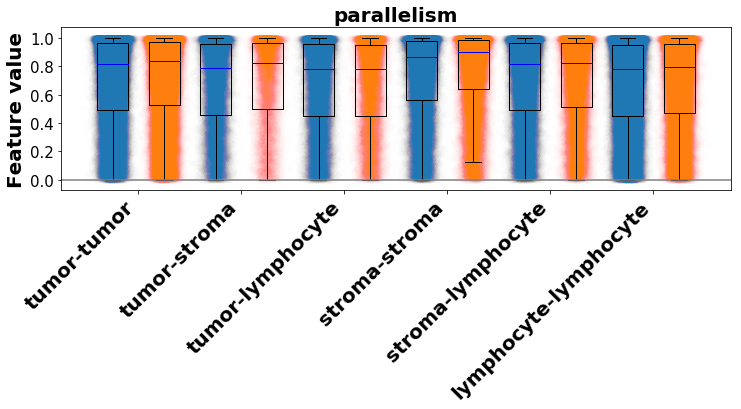

0 vs. 1: Ttest_indResult(statistic=-2.0605988113977096, pvalue=0.03934288702986269)
1 vs. 2: Ttest_indResult(statistic=2.5703122432647865, pvalue=0.010163003730011472)
2 vs. 7: Ttest_indResult(statistic=-49.35659790675771, pvalue=0.0)
7 vs. 8: Ttest_indResult(statistic=15.94269239432269, pvalue=3.658458128933398e-57)
8 vs. 14: Ttest_indResult(statistic=10.292366365144275, pvalue=7.755096587084079e-25)
0 vs. 0 Ttest_1sampResult(statistic=890.9994258795932, pvalue=0.0)
1 vs. 0 Ttest_1sampResult(statistic=286.50445922920005, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=355.6395303257243, pvalue=0.0)
7 vs. 0 Ttest_1sampResult(statistic=677.5508148144509, pvalue=0.0)
8 vs. 0 Ttest_1sampResult(statistic=511.56569059418655, pvalue=0.0)
14 vs. 0 Ttest_1sampResult(statistic=732.638839880886, pvalue=0.0)
class 1 ADC vs. SCC Ttest_indResult(statistic=-15.576167230460824, pvalue=1.1139125011674535e-54)
class 2 ADC vs. SCC Ttest_indResult(statistic=-6.960663740921783, pvalue=3.426796357870929e-1

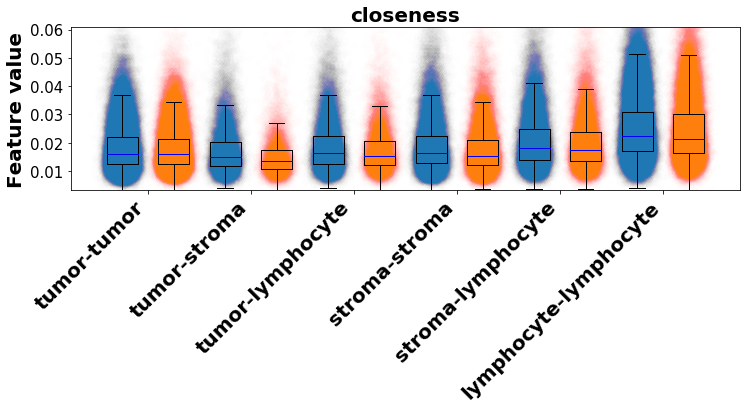

0 vs. 1: Ttest_indResult(statistic=45.05208594184188, pvalue=0.0)
1 vs. 2: Ttest_indResult(statistic=0.31576913229656467, pvalue=0.7521788130543988)
2 vs. 7: Ttest_indResult(statistic=18.507663880218423, pvalue=2.3800613060636058e-76)
7 vs. 8: Ttest_indResult(statistic=-17.88186662889271, pvalue=2.0148244336964156e-71)
8 vs. 14: Ttest_indResult(statistic=-65.75610225598568, pvalue=0.0)
0 vs. 0 Ttest_1sampResult(statistic=876.1156800698016, pvalue=0.0)
1 vs. 0 Ttest_1sampResult(statistic=282.9296708790058, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=346.14611607187294, pvalue=0.0)
7 vs. 0 Ttest_1sampResult(statistic=487.094196255886, pvalue=0.0)
8 vs. 0 Ttest_1sampResult(statistic=432.7010312504879, pvalue=0.0)
14 vs. 0 Ttest_1sampResult(statistic=636.5509111632612, pvalue=0.0)
class 1 ADC vs. SCC Ttest_indResult(statistic=15.876411469424097, pvalue=9.767927018295532e-57)
class 2 ADC vs. SCC Ttest_indResult(statistic=30.392969980835215, pvalue=3.9833018455641154e-201)
class 3 ADC vs

In [301]:
# Box-plot with scatter
# Edge features
'''
    0: 1-1; 1: 1-2; 2: 1-3; 3: 1-4; 4: 1-5; 5: 1-6
    6: 2-1; 7: 2-2; 8: 2-3; 9: 2-4; 10: 2-5; 11: 2-6
    12: 3-1; 13: 3-2; 14: 3-3; 15: 3-4; 16: 3-5; 17: 3-6
    18: 4-1; 19: 4-2; 20: 4-3; 21: 4-4; 22: 4-5; 23: 4-6
    24: 5-1; 25: 5-2; 26: 5-3; 27: 5-4; 28: 5-5; 29: 5-6
    30: 6-1; 31: 6-2; 32: 6-3; 33: 6-4; 34: 6-5; 35: 6-6
'''
xticks = [0, 1, 2, 7, 8, 14]
xtick_names = ['tumor-tumor', 'tumor-stroma', 'tumor-lymphocyte', 
               'stroma-stroma', 'stroma-lymphocyte', 'lymphocyte-lymphocyte']
for feature_id, feature_name in enumerate(["parallelism", "closeness"]):
    #### ADC
    vals = [[] for _ in xticks]
    for x_grad, cell_type in zip(edges_adc, edges_adc):
        x_grad = np.abs(x_grad.detach().cpu().numpy())
        cell_type = cell_type.detach().cpu().numpy()[:, 0]
        for _, xtick in enumerate(xticks):
            temp = x_grad[cell_type == xtick, feature_id + 1]
            vals[_].extend(list(temp))
            # vals[_].append(np.average(temp))

    i = 1
    plt.figure(figsize=(12, 3))
    # plt.violinplot(vals, showmeans=False, showextrema=False)
    plt.boxplot(vals, showfliers=False, medianprops=dict(color='b'), widths=0.3)
    for val in vals:
        if i == 1:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15, val, alpha=0.002, label='ADC', c='tab:blue')
        else:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15, val, alpha=0.002,  c='tab:blue')
        plt.xticks(rotation=45, ha="right")
        i += 1
    from scipy.stats import sem
    # plt.errorbar(np.arange(1, 1 + len(xticks)), [np.average(_) for _ in vals], [np.std(_) for _ in vals], 
    #              linestyle='None', marker='o', fmt='-o', c='k', elinewidth=2, capsize=10)
    # plt.ylabel('Feature value', weight='bold', fontsize=20)
    # plt.xticks(np.arange(1,  1 + len(xticks)), xtick_names, weight='bold', fontsize=20)
    # plt.yticks(fontsize=15)
    # plt.ylim(np.min([np.quantile(_, 0.1) for _ in vals]), 
    #     np.max([np.quantile(_, 0.9) for _ in vals]))
    # plt.title(feature_name, weight='bold', fontsize=20)
    # plt.axhline(0, c='gray')
    # plt.show()

    from scipy.stats import ttest_ind, ttest_1samp
    for i in range(len(vals) - 1):
        print("{} vs. {}:".format(xticks[i], xticks[i + 1]), ttest_ind(vals[i], vals[i + 1], nan_policy='omit'))
    for i in range(len(vals)):
        print("{} vs. 0".format(xticks[i]), ttest_1samp(vals[i], 0, nan_policy='omit'))
        
    #### SCC
    vals_2 = [[] for _ in xticks]
    for x_grad, cell_type in zip(edges_scc, edges_scc):
        x_grad = np.abs(x_grad.detach().cpu().numpy())
        cell_type = cell_type.detach().cpu().numpy()[:, 0]
        for _, xtick in enumerate(xticks):
            vals_2[_].extend(list(x_grad[cell_type == xtick, feature_id + 1]))

    i = 1
    # plt.violinplot(vals_2, showmeans=False, showextrema=False)
    plt.boxplot(vals_2, positions=[_ + 1.5 for _, __ in enumerate(xticks)], showfliers=False, medianprops=dict(color='b'), 
               widths=0.3)
    for val in vals_2:
        if i == 1:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15 + 0.5, val, alpha=0.002, label='SCC', c='tab:orange')
        else:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15 + 0.5, val, alpha=0.002, c='tab:orange')
        i += 1
    from scipy.stats import sem
    # plt.errorbar(np.arange(1, 1 + len(xticks)) + 0.5, [np.average(_) for _ in vals_2], [np.std(_) for _ in vals_2], 
    #              linestyle='None', marker='o', fmt='-o', c='k', elinewidth=2, capsize=10)
    
    plt.ylabel('Feature value', weight='bold', fontsize=20)
    plt.xticks(np.arange(1,  1 + len(xticks)) + 0.25, xtick_names, weight='bold', fontsize=20)
    plt.yticks(fontsize=15)
    if feature_name in ['parallelism']:
        # plt.ylim(0, 1)
        pass
    else:
        plt.ylim(np.min([np.quantile(_, 0) for _ in vals]), 
                 np.max([np.quantile(_, 0.99) for _ in vals]))
    plt.title(feature_name, weight='bold', fontsize=20)
    plt.axhline(0, c='gray')
    plt.xlim(0.5, len(xticks) + 1)
    plt.show()

    from scipy.stats import ttest_ind, ttest_1samp
    for i in range(len(vals) - 1):
        print("{} vs. {}:".format(xticks[i], xticks[i + 1]), ttest_ind(vals[i], vals_2[i + 1], nan_policy='omit'))
    for i in range(len(vals)):
        print("{} vs. 0".format(xticks[i]), ttest_1samp(vals_2[i], 0, nan_policy='omit'))
        
    ### ADC vs. SCC comparison
    from scipy.stats import ttest_ind
    for i in range(len(vals)):
        print("class {} ADC vs. SCC".format(i + 1), ttest_ind(vals[i], vals_2[i], nan_policy='omit'))
        

0 vs. 1: Ttest_indResult(statistic=17.027803289381087, pvalue=5.7158236539988575e-65)
1 vs. 2: Ttest_indResult(statistic=8.686612141415367, pvalue=3.80031686548672e-18)
2 vs. 7: Ttest_indResult(statistic=10.259417681272309, pvalue=1.0983341638158705e-24)
7 vs. 8: Ttest_indResult(statistic=32.304828168547736, pvalue=3.691382653997466e-228)
8 vs. 14: Ttest_indResult(statistic=11.195471827532199, pvalue=4.3592367867378205e-29)
0 vs. 0 Ttest_1sampResult(statistic=90.35377265542124, pvalue=0.0)
1 vs. 0 Ttest_1sampResult(statistic=29.069847092237328, pvalue=9.87797206706122e-184)
2 vs. 0 Ttest_1sampResult(statistic=8.334134123118316, pvalue=8.020657442083584e-17)
7 vs. 0 Ttest_1sampResult(statistic=17.6270241303289, pvalue=2.0880021072442286e-69)
8 vs. 0 Ttest_1sampResult(statistic=-32.75169112711101, pvalue=1.541549749889915e-233)
14 vs. 0 Ttest_1sampResult(statistic=-33.89198339476949, pvalue=5.353287830196331e-251)


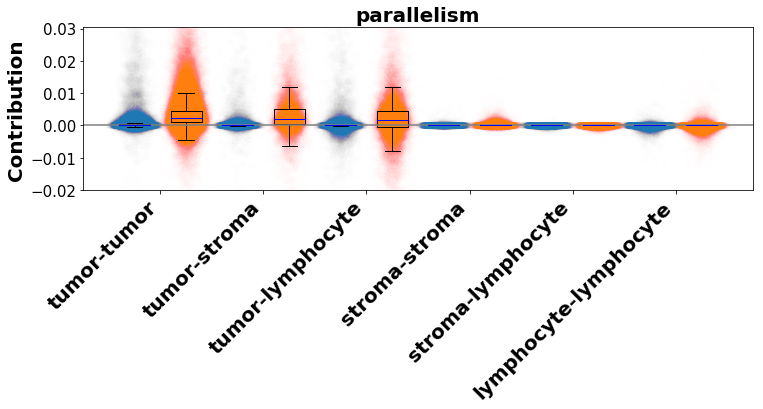

0 vs. 1: Ttest_indResult(statistic=-123.90181028818638, pvalue=0.0)
1 vs. 2: Ttest_indResult(statistic=-43.649277334895885, pvalue=0.0)
2 vs. 7: Ttest_indResult(statistic=3.4043210102082258, pvalue=0.0006635388989950045)
7 vs. 8: Ttest_indResult(statistic=68.49279422452224, pvalue=0.0)
8 vs. 14: Ttest_indResult(statistic=35.00978676287563, pvalue=1.396326422187195e-267)
0 vs. 0 Ttest_1sampResult(statistic=228.55267498016696, pvalue=0.0)
1 vs. 0 Ttest_1sampResult(statistic=56.03516463666211, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=41.37741251154646, pvalue=0.0)
7 vs. 0 Ttest_1sampResult(statistic=46.324859364957504, pvalue=0.0)
8 vs. 0 Ttest_1sampResult(statistic=-58.82602354639339, pvalue=0.0)
14 vs. 0 Ttest_1sampResult(statistic=-45.651360018753245, pvalue=0.0)
class 1 ADC vs. SCC Ttest_indResult(statistic=-204.13887612318365, pvalue=0.0)
class 2 ADC vs. SCC Ttest_indResult(statistic=-78.03136658202945, pvalue=0.0)
class 3 ADC vs. SCC Ttest_indResult(statistic=-48.746376743857

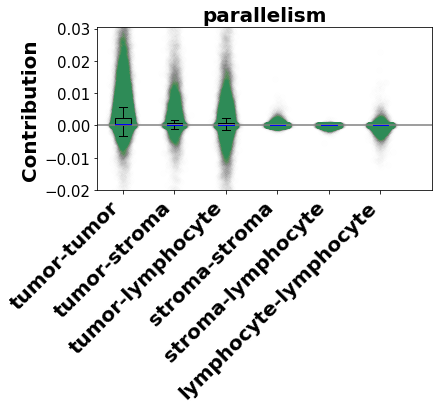

Summarized comparison
0 vs. 1: Ttest_indResult(statistic=35.553215802634845, pvalue=2.439324107347569e-276)
1 vs. 2: Ttest_indResult(statistic=11.137208674453403, pvalue=8.534797831942741e-29)
2 vs. 7: Ttest_indResult(statistic=53.71894492580512, pvalue=0.0)
7 vs. 8: Ttest_indResult(statistic=68.32240333301546, pvalue=0.0)
8 vs. 14: Ttest_indResult(statistic=17.23205162157819, pvalue=1.6137028692303088e-66)
0 vs. 0 Ttest_1sampResult(statistic=229.19005588644393, pvalue=0.0)
1 vs. 0 Ttest_1sampResult(statistic=59.12525814655023, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=40.44336551215274, pvalue=0.0)
7 vs. 0 Ttest_1sampResult(statistic=49.01967468780576, pvalue=0.0)
8 vs. 0 Ttest_1sampResult(statistic=-66.41970048245021, pvalue=0.0)
14 vs. 0 Ttest_1sampResult(statistic=-55.32080198898963, pvalue=0.0)
End of Summarized comparison
0 vs. 1: Ttest_indResult(statistic=-29.64150681314839, pvalue=1.2155564352721594e-192)
1 vs. 2: Ttest_indResult(statistic=-0.9478316922969144, pvalue=0.34

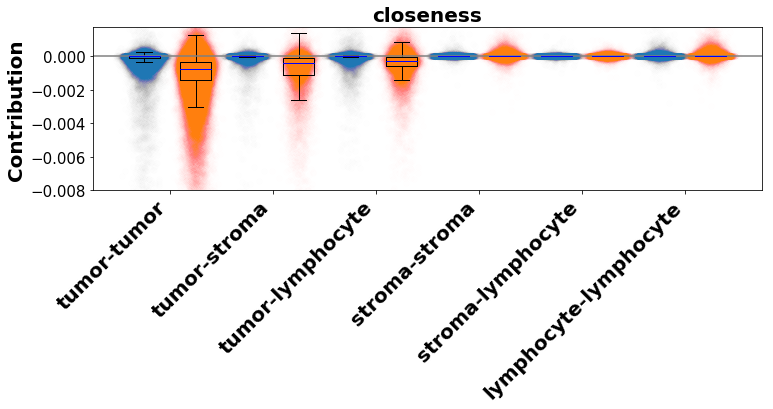

0 vs. 1: Ttest_indResult(statistic=120.71492496260277, pvalue=0.0)
1 vs. 2: Ttest_indResult(statistic=65.4062354645782, pvalue=0.0)
2 vs. 7: Ttest_indResult(statistic=-42.42255936721529, pvalue=0.0)
7 vs. 8: Ttest_indResult(statistic=1.3980839976403177, pvalue=0.16209038371242832)
8 vs. 14: Ttest_indResult(statistic=-32.27127830443917, pvalue=8.48108087841492e-228)
0 vs. 0 Ttest_1sampResult(statistic=-250.128596277878, pvalue=0.0)
1 vs. 0 Ttest_1sampResult(statistic=-61.245600423484944, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=-70.1009880865969, pvalue=0.0)
7 vs. 0 Ttest_1sampResult(statistic=24.74860247546013, pvalue=1.6213517435057934e-134)
8 vs. 0 Ttest_1sampResult(statistic=5.1963438590559825, pvalue=2.041403078987208e-07)
14 vs. 0 Ttest_1sampResult(statistic=39.24257976427553, pvalue=0.0)
class 1 ADC vs. SCC Ttest_indResult(statistic=221.22927523208227, pvalue=0.0)
class 2 ADC vs. SCC Ttest_indResult(statistic=86.51803958971911, pvalue=0.0)
class 3 ADC vs. SCC Ttest_indResu

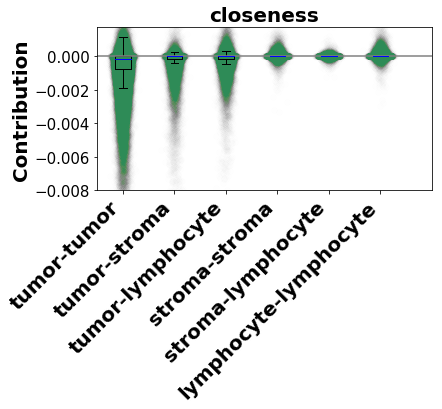

Summarized comparison
0 vs. 1: Ttest_indResult(statistic=-50.921220186722884, pvalue=0.0)
1 vs. 2: Ttest_indResult(statistic=-25.068940970653376, pvalue=2.4294473927774955e-138)
2 vs. 7: Ttest_indResult(statistic=-105.02410158295116, pvalue=0.0)
7 vs. 8: Ttest_indResult(statistic=21.691681873747118, pvalue=3.065643662470032e-104)
8 vs. 14: Ttest_indResult(statistic=-24.28162535452014, pvalue=3.813844231163382e-130)
0 vs. 0 Ttest_1sampResult(statistic=-249.7560685342372, pvalue=0.0)
1 vs. 0 Ttest_1sampResult(statistic=-62.53899090230616, pvalue=0.0)
2 vs. 0 Ttest_1sampResult(statistic=-74.50110604438352, pvalue=0.0)
7 vs. 0 Ttest_1sampResult(statistic=27.47091891223276, pvalue=1.1184993185586706e-165)
8 vs. 0 Ttest_1sampResult(statistic=5.929965850686705, pvalue=3.038502308133364e-09)
14 vs. 0 Ttest_1sampResult(statistic=43.22793004652104, pvalue=0.0)
End of Summarized comparison


In [320]:
# Box-plot with scatter
# Edge contributions
'''
    0: 1-1; 1: 1-2; 2: 1-3; 3: 1-4; 4: 1-5; 5: 1-6
    6: 2-1; 7: 2-2; 8: 2-3; 9: 2-4; 10: 2-5; 11: 2-6
    12: 3-1; 13: 3-2; 14: 3-3; 15: 3-4; 16: 3-5; 17: 3-6
    18: 4-1; 19: 4-2; 20: 4-3; 21: 4-4; 22: 4-5; 23: 4-6
    24: 5-1; 25: 5-2; 26: 5-3; 27: 5-4; 28: 5-5; 29: 5-6
    30: 6-1; 31: 6-2; 32: 6-3; 33: 6-4; 34: 6-5; 35: 6-6
'''
xticks = [0, 1, 2, 7, 8, 14]
xtick_names = ['tumor-tumor', 'tumor-stroma', 'tumor-lymphocyte', 
               'stroma-stroma', 'stroma-lymphocyte', 'lymphocyte-lymphocyte']
for feature_id, feature_name in enumerate(["parallelism", "closeness"]):
    #### ADC
    vals = [[] for _ in xticks]
    for x_grad, cell_type in zip(edge_gradients_adc, edges_adc):
        x_grad = x_grad.detach().cpu().numpy()
        cell_type = cell_type.detach().cpu().numpy()[:, 0]
        for _, xtick in enumerate(xticks):
            vals[_].extend(list(x_grad[cell_type == xtick, feature_id + 1]))

    i = 1
    plt.figure(figsize=(12, 3))
    # plt.violinplot(vals, showmeans=False, showextrema=False)
    plt.boxplot(vals, showfliers=False, medianprops=dict(color='b'), widths=0.3)
    for val in vals:
        if i == 1:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15, val, alpha=0.002, label='ADC', c='tab:blue')
        else:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15, val, alpha=0.002, c='tab:blue')
        plt.xticks(rotation=45, ha="right")
        i += 1
    from scipy.stats import sem
    # plt.errorbar(np.arange(1, 1 + len(xticks)), [np.average(_) for _ in vals], [np.std(_) for _ in vals], 
    #              linestyle='None', marker='o', fmt='-o', c='k', elinewidth=2, capsize=10)
    # plt.ylabel('Feature value', weight='bold', fontsize=20)
    # plt.xticks(np.arange(1,  1 + len(xticks)), xtick_names, weight='bold', fontsize=20)
    # plt.yticks(fontsize=15)
    # plt.ylim(np.min([np.quantile(_, 0.1) for _ in vals]), 
    #     np.max([np.quantile(_, 0.9) for _ in vals]))
    # plt.title(feature_name, weight='bold', fontsize=20)
    # plt.axhline(0, c='gray')
    # plt.show()

    from scipy.stats import ttest_ind, ttest_1samp
    for i in range(len(vals) - 1):
        print("{} vs. {}:".format(xticks[i], xticks[i + 1]), ttest_ind(vals[i], vals[i + 1], nan_policy='omit'))
    for i in range(len(vals)):
        print("{} vs. 0".format(xticks[i]), ttest_1samp(vals[i], 0, nan_policy='omit'))
        
    #### SCC
    vals_2 = [[] for _ in xticks]
    for x_grad, cell_type in zip(edge_gradients_scc, edges_scc):
        x_grad = x_grad.detach().cpu().numpy()
        cell_type = cell_type.detach().cpu().numpy()[:, 0]
        for _, xtick in enumerate(xticks):
            vals_2[_].extend(list(x_grad[cell_type == xtick, feature_id + 1]))

    i = 1
    # plt.violinplot(vals_2, showmeans=False, showextrema=False)
    plt.boxplot(vals_2, positions=[_ + 1.5 for _, __ in enumerate(xticks)], showfliers=False, medianprops=dict(color='b'), 
               widths=0.3)
    for val in vals_2:
        if i == 1:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15 + 0.5, val, alpha=0.002, label='SCC', c='tab:orange')
        else:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15 + 0.5, val, alpha=0.002, c='tab:orange')
        i += 1
    from scipy.stats import sem
    # plt.errorbar(np.arange(1, 1 + len(xticks)) + 0.5, [np.average(_) for _ in vals_2], [np.std(_) for _ in vals_2], 
    #              linestyle='None', marker='o', fmt='-o', c='k', elinewidth=2, capsize=10)
    
    plt.ylabel('Contribution', weight='bold', fontsize=20)
    plt.xticks(np.arange(1,  1 + len(xticks)) + 0.25, xtick_names, weight='bold', fontsize=20)
    plt.yticks(fontsize=15)
    if feature_name in ['eccentricity']:
        plt.ylim(0, 1)
    else:
        plt.ylim(np.min([np.quantile(_, 0.01) for _ in vals_2]), 
                 np.max([np.quantile(_, 0.99) for _ in vals_2]))
    plt.title(feature_name, weight='bold', fontsize=20)
    plt.axhline(0, c='gray')
    plt.xlim(0.5, len(xticks) + 1)
    plt.show()

    from scipy.stats import ttest_ind, ttest_1samp
    for i in range(len(vals) - 1):
        print("{} vs. {}:".format(xticks[i], xticks[i + 1]), ttest_ind(vals[i], vals_2[i + 1], nan_policy='omit'))
    for i in range(len(vals)):
        print("{} vs. 0".format(xticks[i]), ttest_1samp(vals_2[i], 0, nan_policy='omit'))
        
    ### ADC vs. SCC comparison
    from scipy.stats import ttest_ind
    for i in range(len(vals)):
        print("class {} ADC vs. SCC".format(i + 1), ttest_ind(vals[i], vals_2[i], nan_policy='omit'))
        
        
    #### Combine ADC and SCC contribution together to avoid confusion
    for val, val_2 in zip(vals, vals_2):
        val.extend(val_2)
    i = 1
    plt.figure(figsize=(6, 3))
    # plt.violinplot(vals, showmeans=False, showextrema=False)
    plt.boxplot(vals, showfliers=False, medianprops=dict(color='b'), widths=0.3)
    for val in vals:
        if i == 1:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15, val, alpha=0.002, label='ADC', c='seagreen')
        else:
            plt.scatter([i] * len(val) + np.random.randn(len(val))/15, val, alpha=0.002, c='seagreen')
        plt.xticks(rotation=45, ha="right")
        i += 1
    from scipy.stats import sem
    # plt.errorbar(np.arange(1, 1 + len(xticks)) + 0.5, [np.average(_) for _ in vals_2], [np.std(_) for _ in vals_2], 
    #              linestyle='None', marker='o', fmt='-o', c='k', elinewidth=2, capsize=10)
    plt.ylabel('Contribution', weight='bold', fontsize=20)
    plt.xticks(np.arange(1,  1 + len(xticks)), xtick_names, weight='bold', fontsize=20)
    plt.yticks(fontsize=15)
    if feature_name in ['eccentricity']:
        plt.ylim(0, 1)
    else:
        plt.ylim(np.min([np.quantile(_, 0.01) for _ in vals_2]), 
                 np.max([np.quantile(_, 0.99) for _ in vals_2]))
    plt.title(feature_name, weight='bold', fontsize=20)
    plt.axhline(0, c='gray')
    plt.xlim(0.5, len(xticks) + 1)
    plt.show()
    
    from scipy.stats import ttest_ind, ttest_1samp
    print("Summarized comparison")
    for i in range(len(vals) - 1):
        print("{} vs. {}:".format(xticks[i], xticks[i + 1]), ttest_ind(vals[i], vals[i + 1], nan_policy='omit'))
    for i in range(len(vals)):
        print("{} vs. 0".format(xticks[i]), ttest_1samp(vals[i], 0, nan_policy='omit'))
    print("End of Summarized comparison")

# Session Info

In [49]:
!pip freeze

Please see https://github.com/pypa/pip/issues/5599 for advice on fixing the underlying issue.
To avoid this problem you can invoke Python with '-m pip' instead of running pip directly.
absl-py==0.7.0
altair==3.2.0
argh==0.26.2
ase==3.21.1
astor==0.7.1
astropy==3.2.1
atomicwrites==1.3.0
attrs==19.1.0
autograd==1.2
backcall==0.1.0
base58==1.0.3
bleach==3.1.0
blinker==1.4
boto3==1.10.15
botocore==1.13.15
Bottleneck==1.2.1
certifi==2019.3.9
chardet==3.0.4
Click==7.0
cvxopt==1.2.3
cvxpy==1.0.24
cycler==0.10.0
decorator==4.4.0
defusedxml==0.5.0
dill==0.2.9
docutils==0.15.2
ecos==2.0.7.post1
entrypoints==0.3
enum-compat==0.0.3
environment-kernels==1.1.1
FITS-tools==0.2
future==0.17.1
gast==0.2.2
googledrivedownloader==0.4
grpcio==1.16.0
h5py==2.10.0
image-registration==0.2.4
imagecodecs==2020.5.30
imageio==2.6.1
importlib-metadata==0.23
importlib-resources==5.4.0
ipykernel==5.1.0
ipython==7.4.0
ipython-genutils==0.2.0
ipywidgets==7.4.2
isodate==0.6.0
jedi==0.13.3
Jinja2==2.10.1
jmespath==0.9.